In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'
import sys

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import scipy.misc
from datetime import datetime

import tensorflow as tf

if not os.path.exists('facenet'):
  !git clone https://github.com/davidsandberg/facenet --depth=1

sys.path.insert(0, './facenet/src')
import align.detect_face
import facenet
import scipy.spatial.distance as distance

In [2]:
model_dir = '/home/sabrine/notebook/reid/20170216-091149/'

In [3]:
# starting a session
tf.reset_default_graph()

tf_config = tf.ConfigProto()
tf_config.gpu_options.allow_growth = True
tf_config.allow_soft_placement = True

sess = tf.Session(config=tf_config)

print('loading the detection/alignment network...')
pnet, rnet, onet = align.detect_face.create_mtcnn(sess, None)
print('done!')

print('loading the embedding network...')
meta_file, ckpt_file = facenet.get_model_filenames(model_dir)
restorer = tf.train.import_meta_graph(os.path.join(model_dir, meta_file))
restorer.restore(sess, os.path.join(model_dir, ckpt_file))
print('done!')

# getting input / output tensors
g = tf.get_default_graph()
images_in = g.get_tensor_by_name('input:0')
phase_train_in = g.get_tensor_by_name('phase_train:0')
embeddings = g.get_tensor_by_name('embeddings:0')


loading the detection/alignment network...
done!
loading the embedding network...
done!


In [4]:
import cv2
import os

In [49]:
# List all jpg file from mypath folder and store the absolute path of the first frame into ref
# ref will be an array of faces to be recognize into other images
ref = []

# detection parameters
minsize = 20 
threshold = [ 0.6, 0.7, 0.7 ]
factor = 0.709

mypath = "/home/sabrine/notebook/BIWI_dataset/Training"
for x in os.listdir(mypath):
    stored = False
    for i, f in enumerate(os.listdir(mypath + "/" + x)):
        if str(f).endswith('jpg') and not stored:   
            thePath = mypath + "/" + x + "/" + f
            img = scipy.misc.imread(thePath)
            
            bbs, kps = align.detect_face.detect_face(img, minsize, 
                                             pnet, rnet, onet, threshold, factor)
            kps = np.asarray(kps)
            kps = kps.reshape([2,5,-1]).T
            
            if len(kps) != 0:  
                ref.append(mypath + "/" + x + "/" + f)
                stored = True
                print('Number ' + x + " stored")


Number 036 stored
Number 006 stored
Number 016 stored
Number 030 stored
Number 020 stored
Number 032 stored
Number 011 stored
Number 045 stored
Number 043 stored
Number 028 stored
Number 018 stored
Number 037 stored
Number 042 stored
Number 013 stored
Number 005 stored
Number 019 stored
Number 002 stored
Number 027 stored
Number 039 stored
Number 024 stored
Number 012 stored
Number 026 stored
Number 007 stored
Number 023 stored
Number 033 stored
Number 044 stored
Number 031 stored
Number 021 stored
Number 048 stored
Number 001 stored
Number 047 stored
Number 038 stored
Number 034 stored
Number 022 stored
Number 025 stored
Number 035 stored
Number 009 stored
Number 017 stored
Number 010 stored
Number 041 stored
Number 003 stored
Number 046 stored
Number 049 stored
Number 004 stored
Number 015 stored
Number 029 stored
Number 008 stored
Number 040 stored
Number 000 stored
Number 014 stored


In [48]:
# List all jpg file from mypath folder and store the absolute path of the first frame into ref
# ref will be an array of faces to be recognize into other images
guess = []

# detection parameters
minsize = 20 
threshold = [ 0.6, 0.7, 0.7 ]
factor = 0.709

mypath = "/home/sabrine/notebook/BIWI_dataset/Testing/Still"
for x in os.listdir(mypath):
    stored = False
    for i, f in enumerate(os.listdir(mypath + "/" + x)):
        if str(f).endswith('jpg') and not stored:   
            thePath = mypath + "/" + x + "/" + f
            img = scipy.misc.imread(thePath)
            
            bbs, kps = align.detect_face.detect_face(img, minsize, 
                                             pnet, rnet, onet, threshold, factor)
            kps = np.asarray(kps)
            kps = kps.reshape([2,5,-1]).T
            
            if len(kps) != 0:  
                guess.append(mypath + "/" + x + "/" + f)
                stored = True
                print('Number ' + x + " stored")


Number 036 stored
Number 006 stored
Number 016 stored
Number 030 stored
Number 032 stored
Number 011 stored
Number 037 stored
Number 019 stored
Number 002 stored
Number 027 stored
Number 039 stored
Number 024 stored
Number 026 stored
Number 023 stored
Number 044 stored
Number 031 stored
Number 021 stored
Number 001 stored
Number 047 stored
Number 022 stored
Number 017 stored
Number 010 stored
Number 003 stored
Number 046 stored
Number 049 stored
Number 008 stored
Number 040 stored
Number 000 stored


detecting faces...


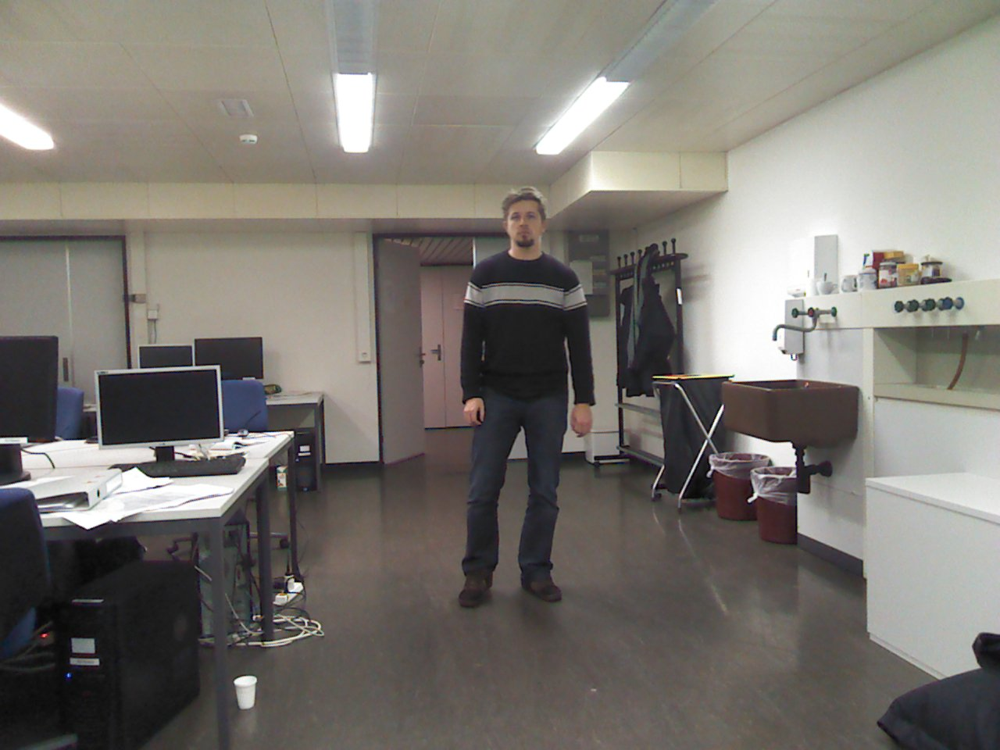

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 648.43389024  258.02029923  691.62592782  312.54981708    0.99988949]]


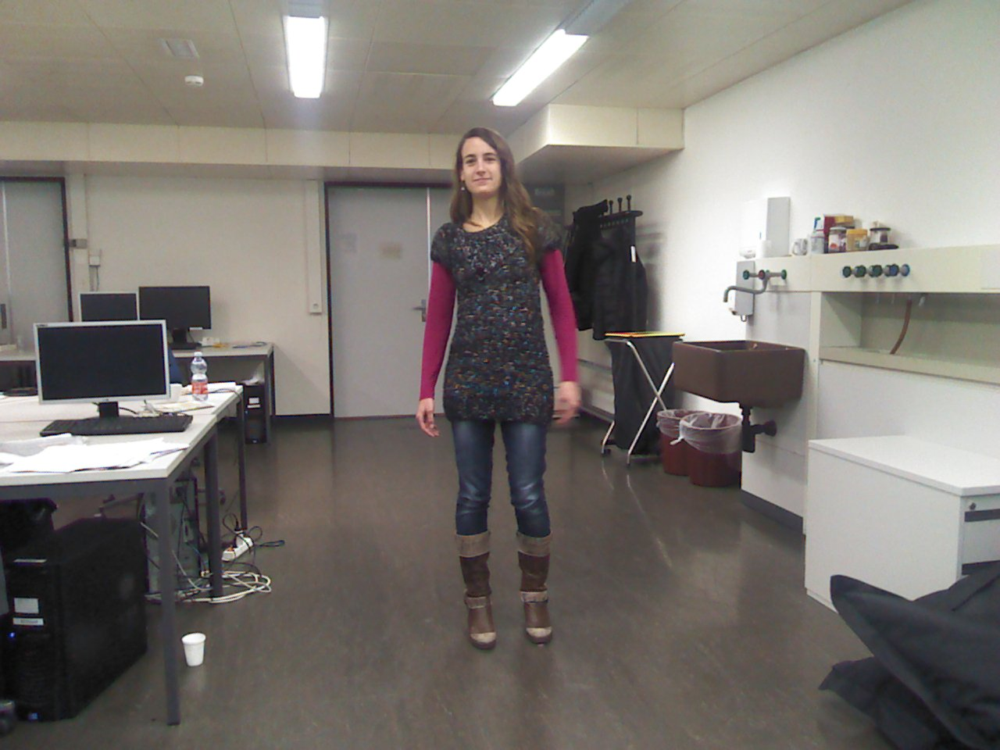

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 589.49268449  178.77437174  641.12194242  246.856884      1.        ]]


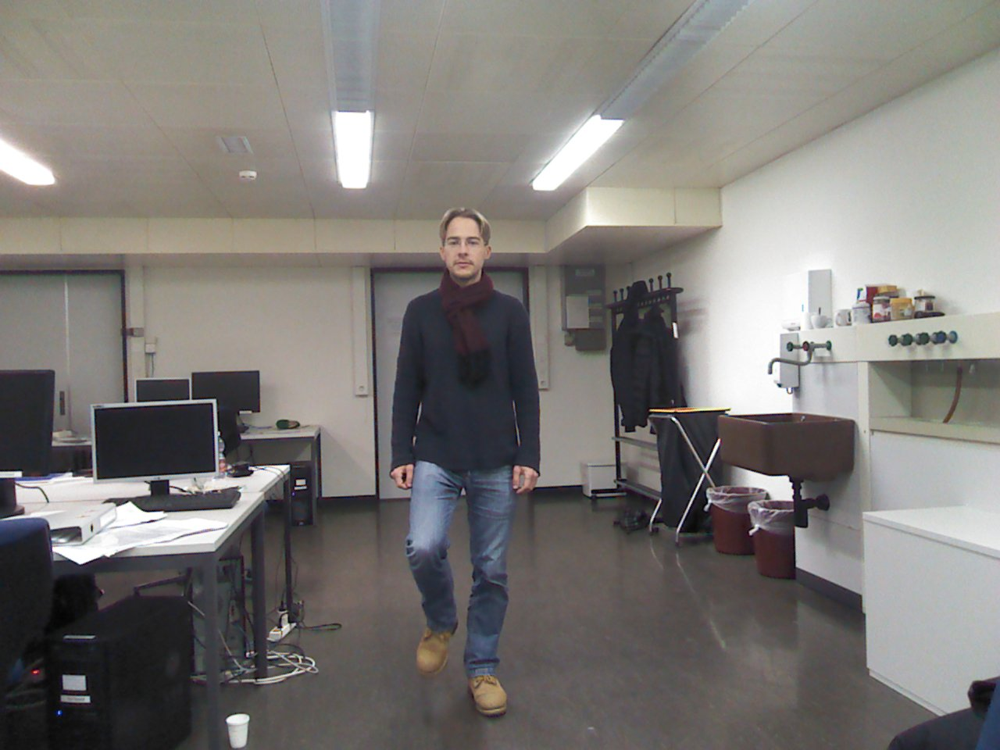

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 568.6242955   283.10910855  617.94834812  353.49853496    0.99920398]]


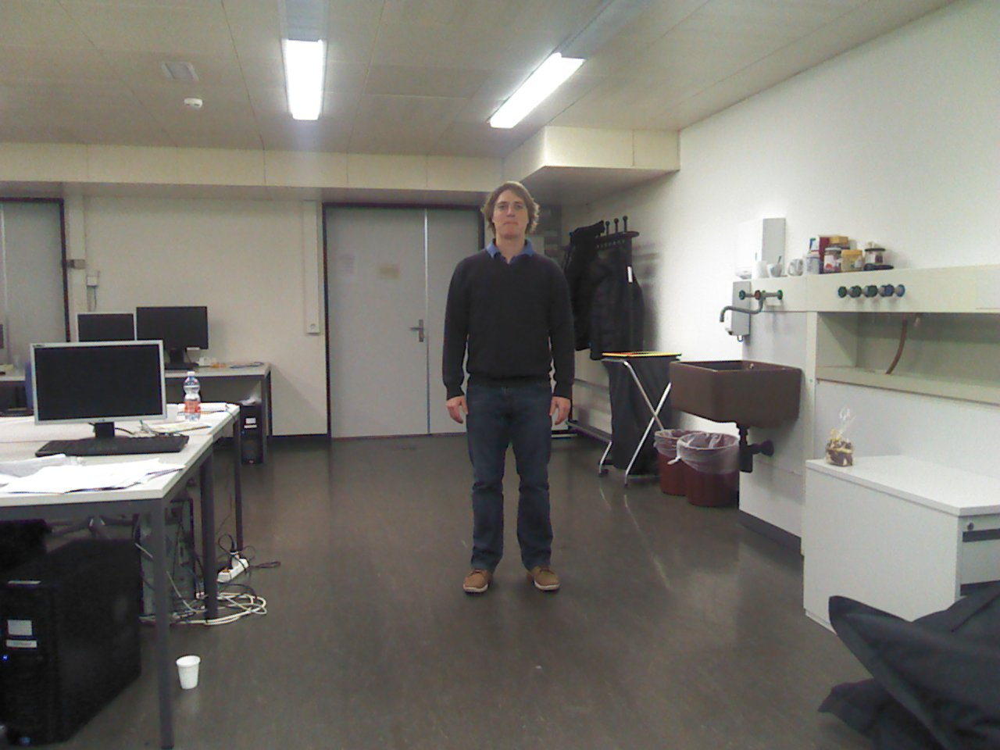

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 631.3279047   244.46144122  674.16462106  299.48132084    0.99997413]]


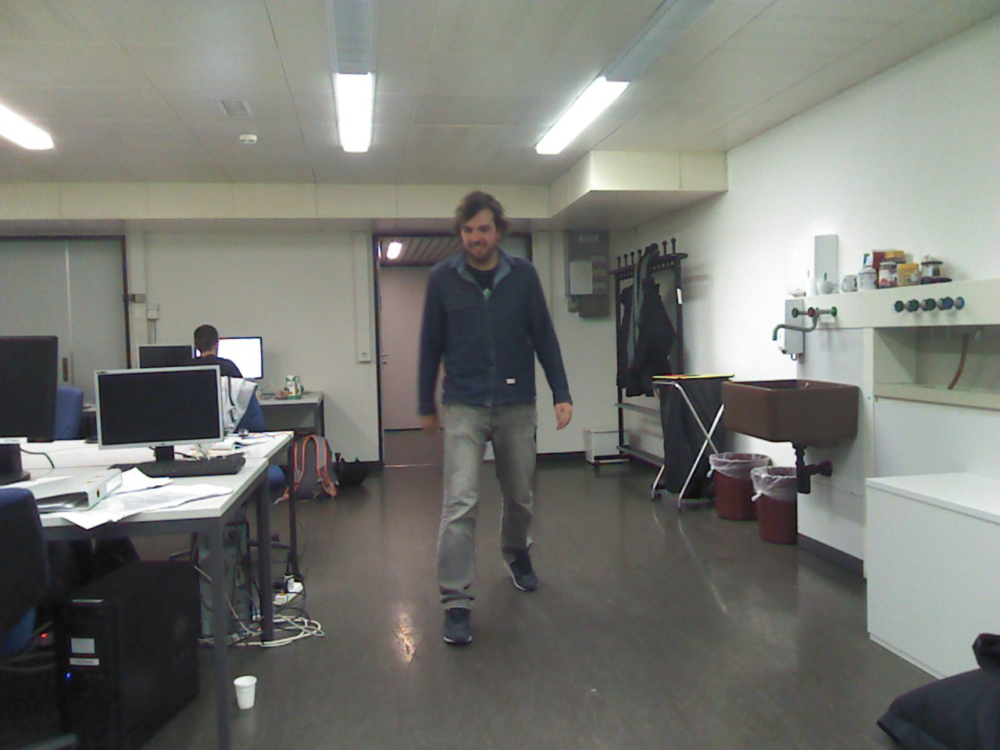

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 590.78460687  274.96028333  634.18267144  329.89501077    0.99822479]]


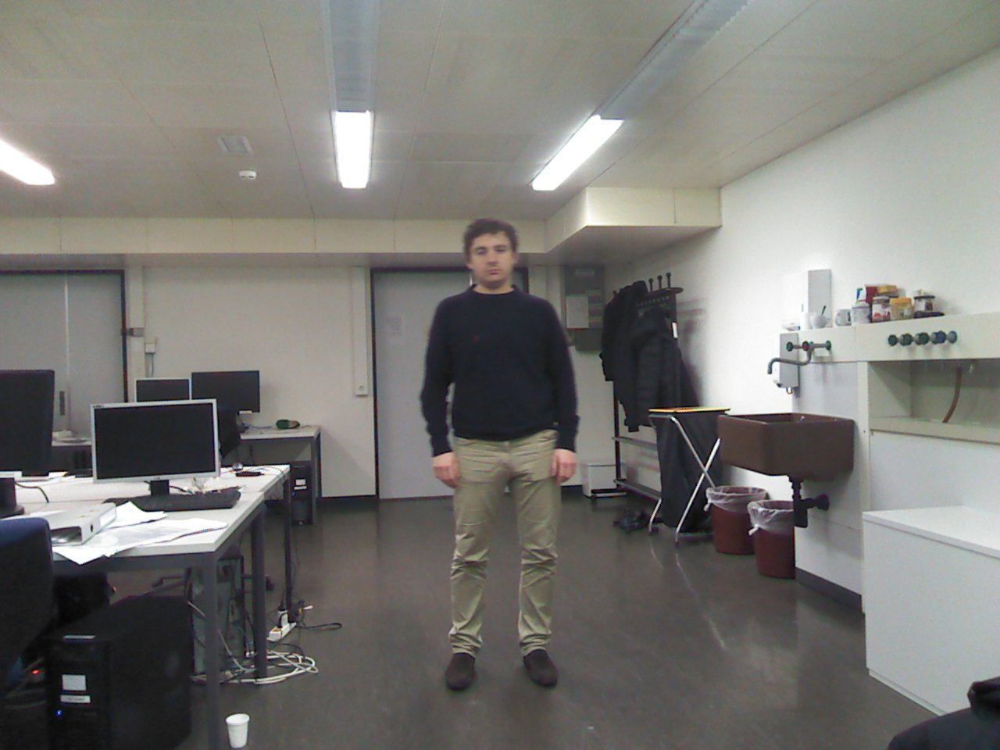

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 601.04088593  298.34938145  654.19231224  360.46379328    0.99999368]]


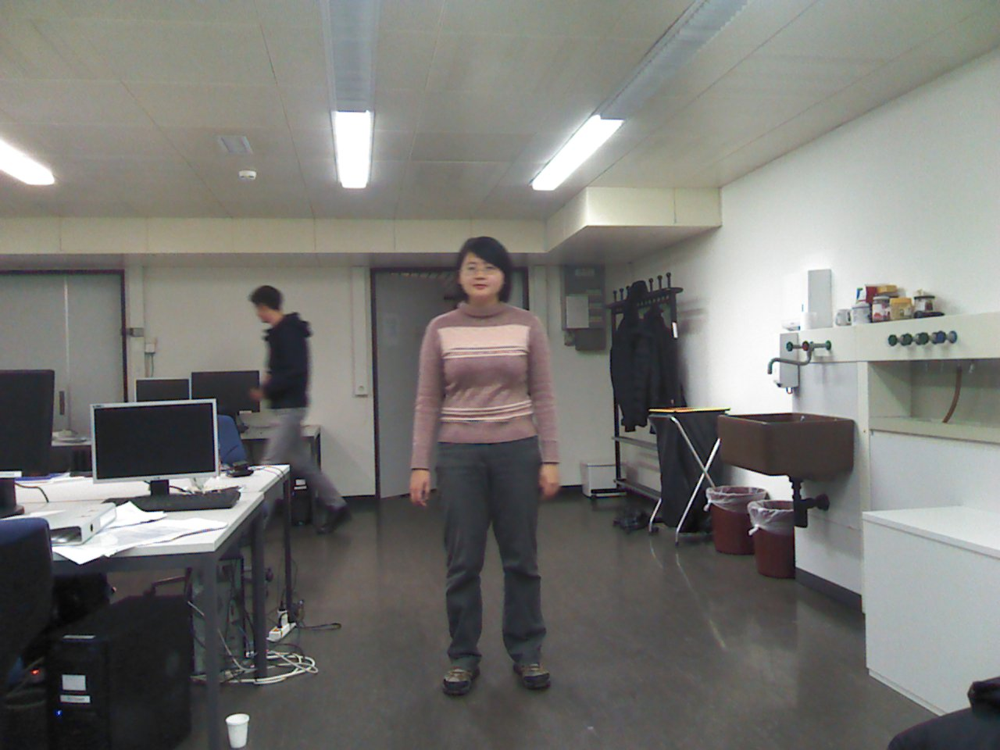

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 588.91264557  323.47710594  639.97505304  378.80631877    0.99973053]]


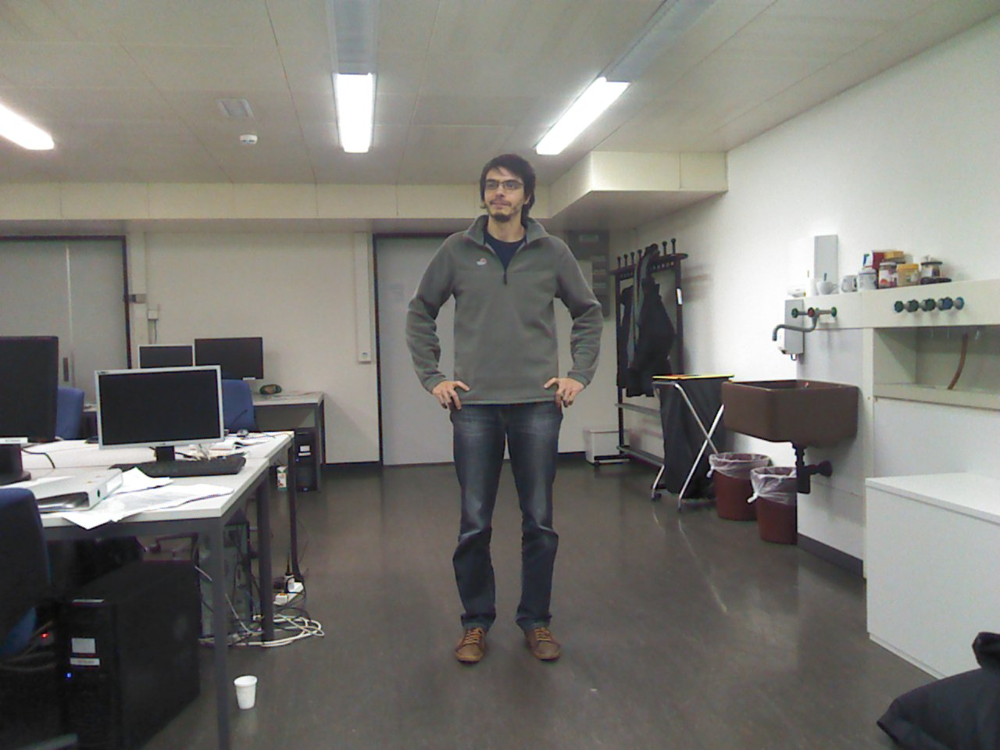

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 618.30161901  213.15867175  668.20013982  278.16539744    0.99984252]]


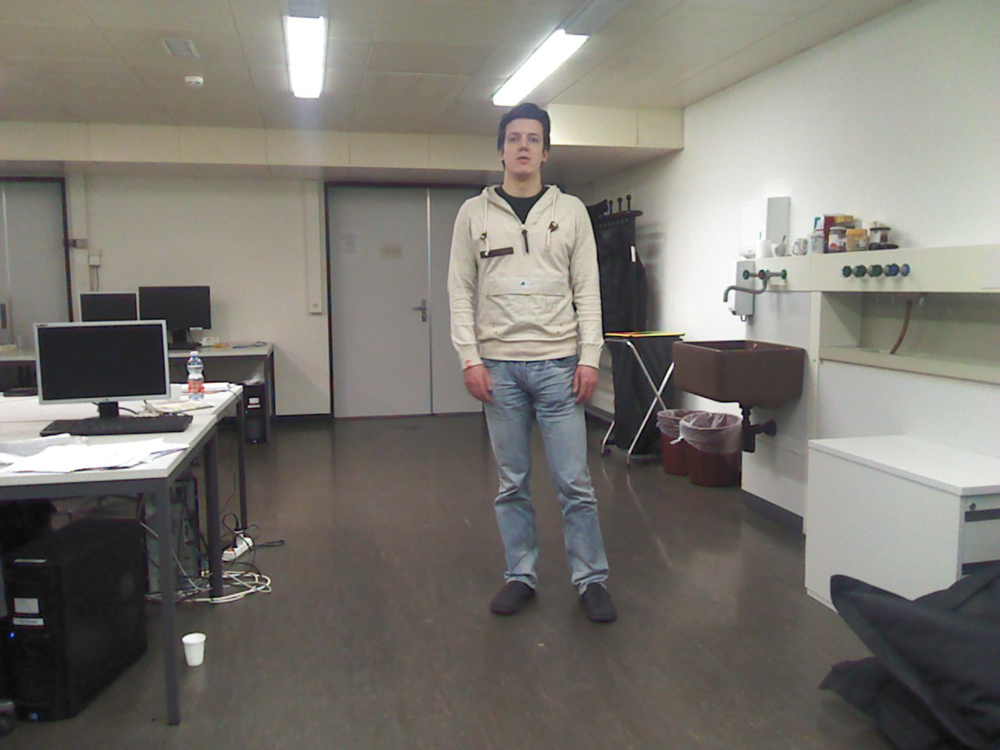

('paaath : ', <type 'numpy.string_'>)
the bbs [[  6.44715984e+02   1.53071351e+02   6.94995291e+02   2.18152726e+02
    9.99991655e-01]
 [  8.18638505e+02   2.93086253e+02   8.46574374e+02   3.27103533e+02
    7.54816175e-01]]


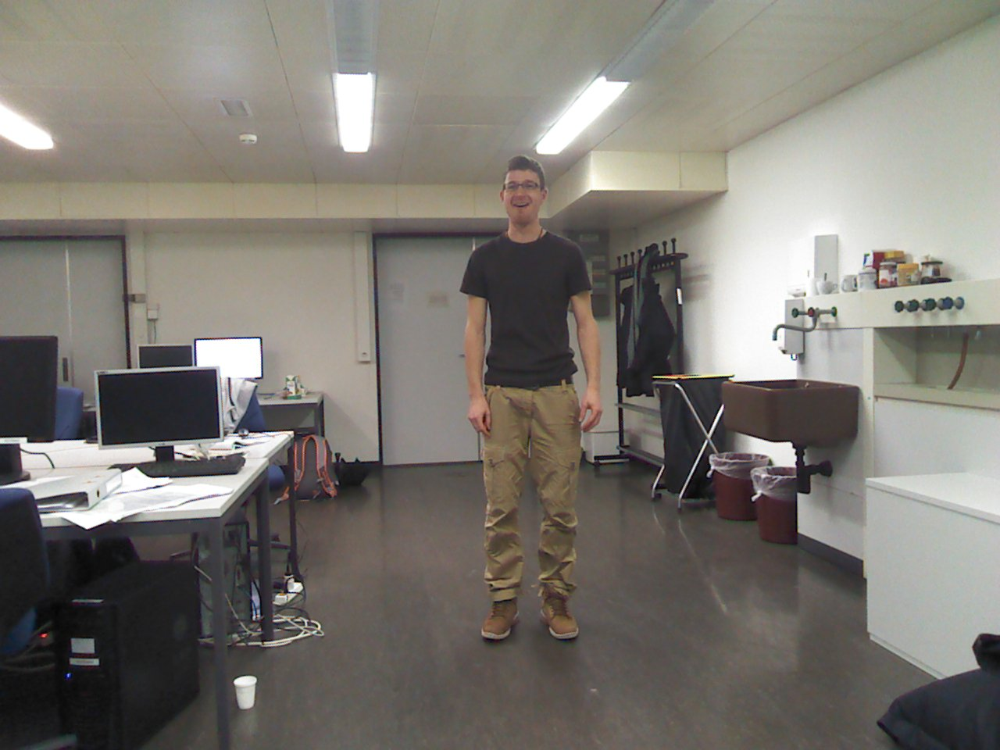

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 643.93884264  216.82886107  691.76076324  279.30223871    0.99714321]]


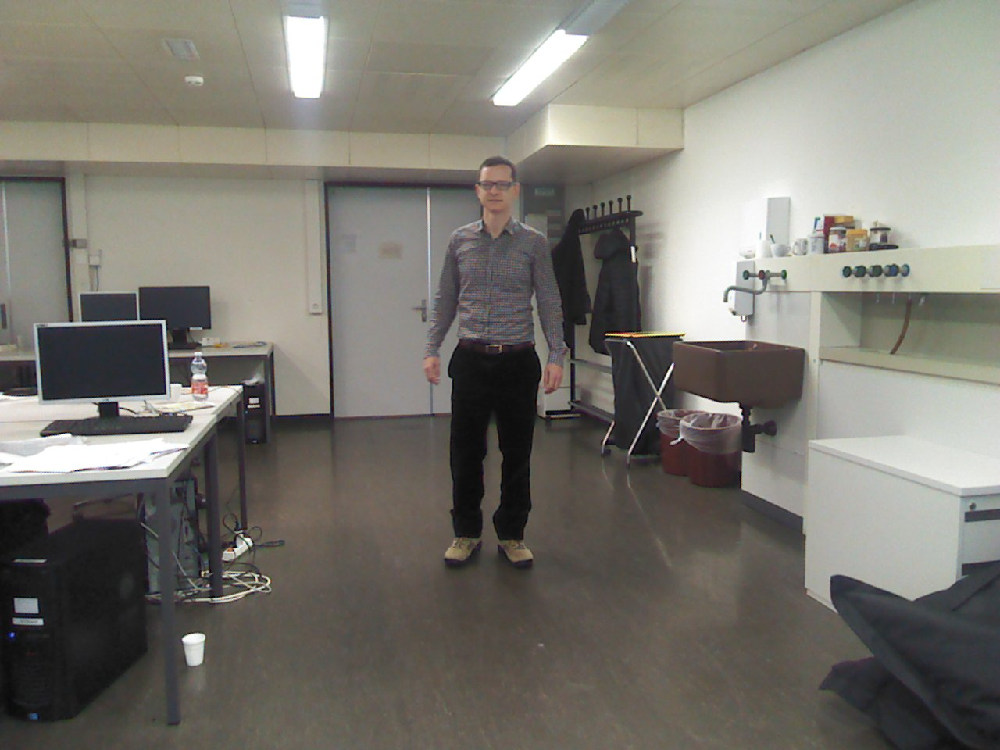

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 612.35493905  214.07135198  656.48718973  270.02324156    0.99961841]]


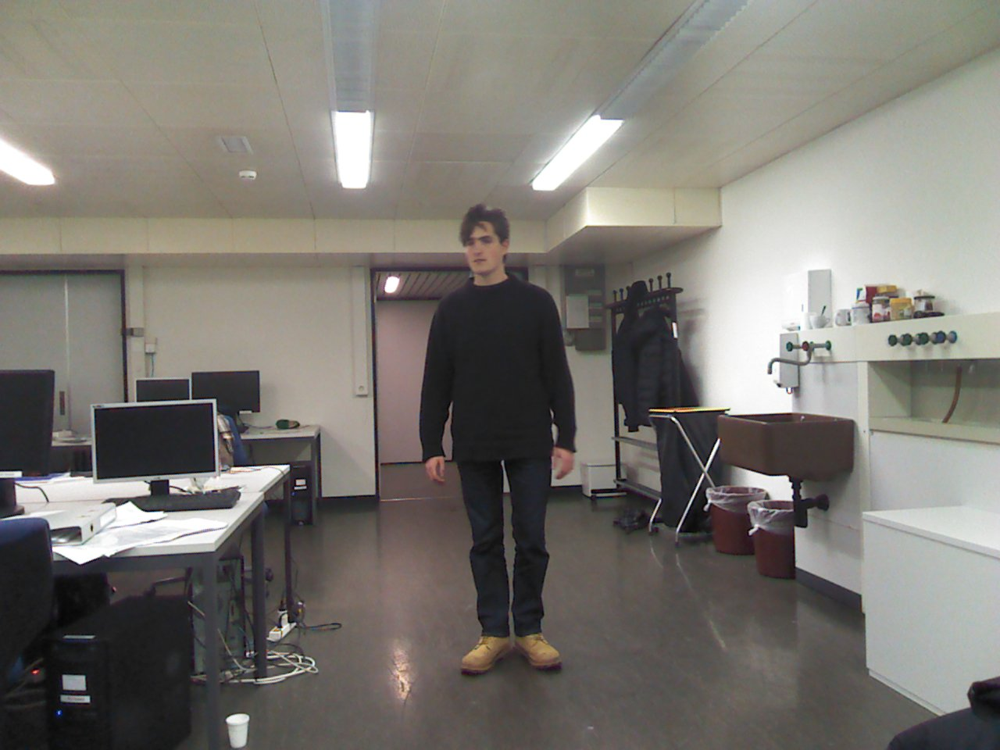

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 593.6257875   288.60362446  640.41221616  347.74077109    0.99894077]]


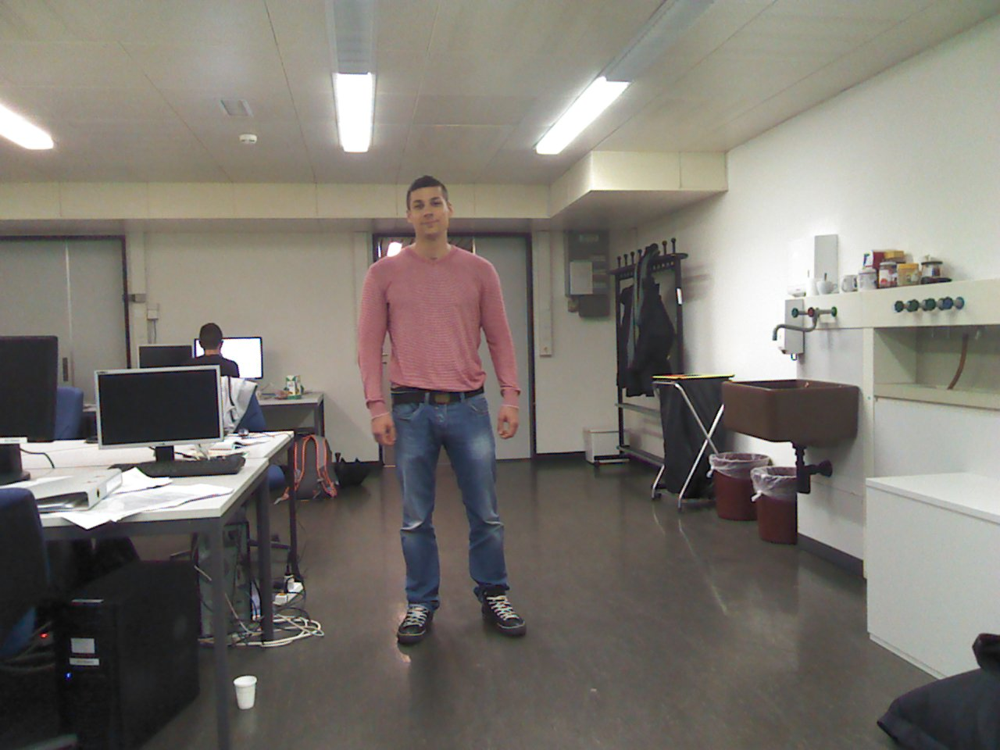

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 523.30911261  241.72380769  571.26752397  299.2266316     0.99944896]]


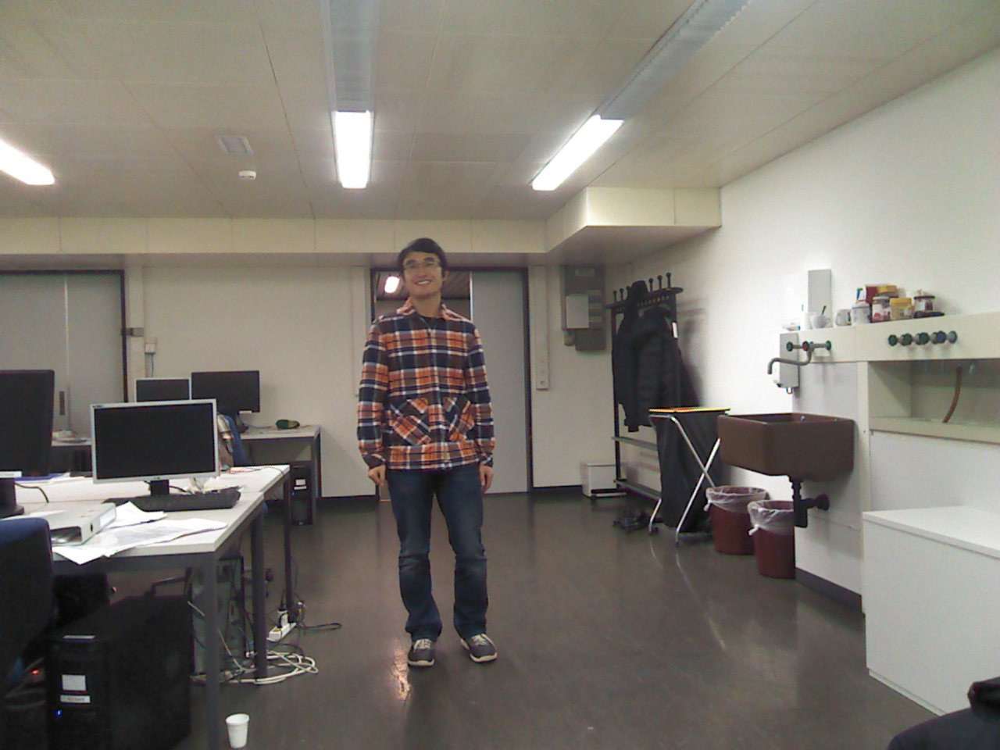

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 515.25015169  321.07422889  563.68652147  376.34520253    0.9996624 ]]


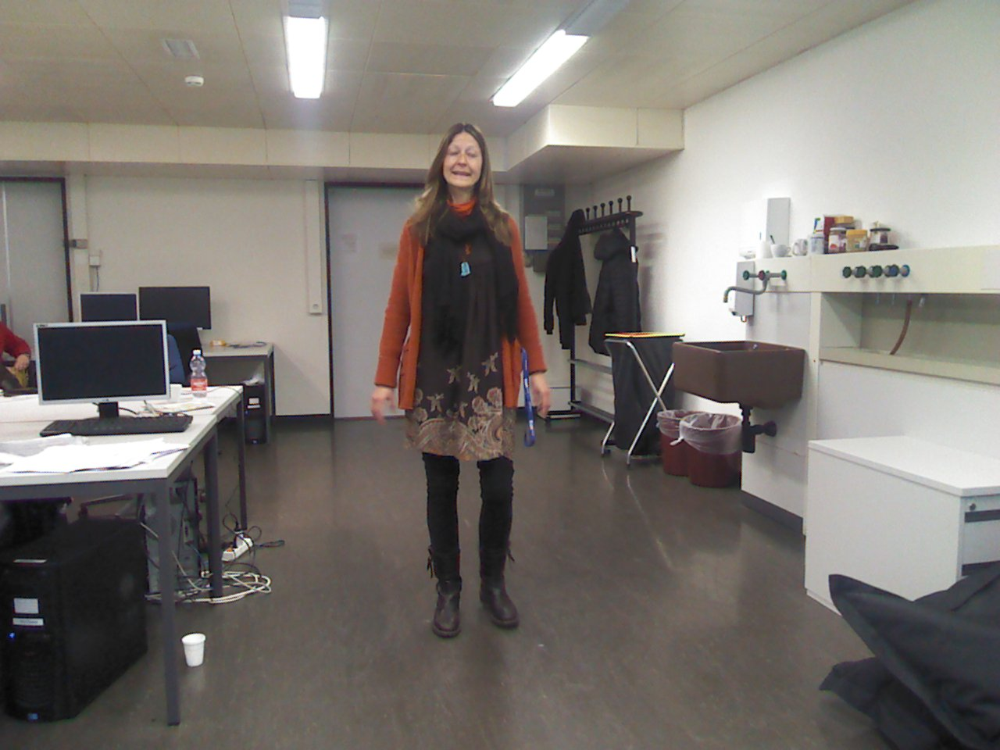

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 564.83956571  171.91482162  615.7156973   239.187518      0.99999893]]


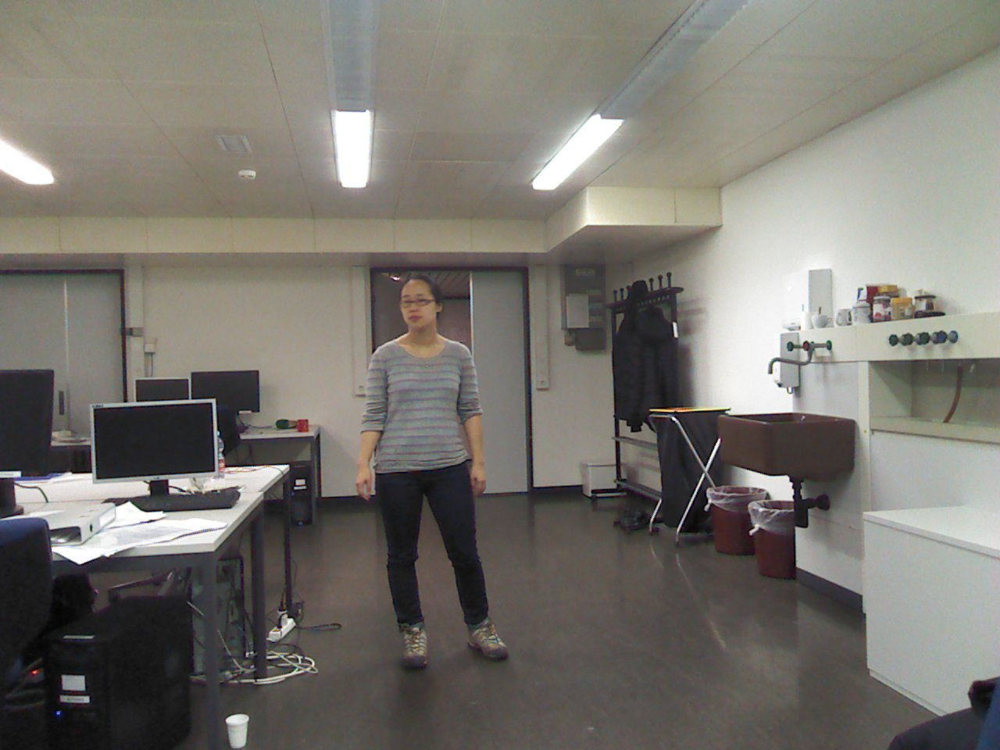

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 511.90699048  363.60028108  554.56733504  419.10765972    0.99913031]]


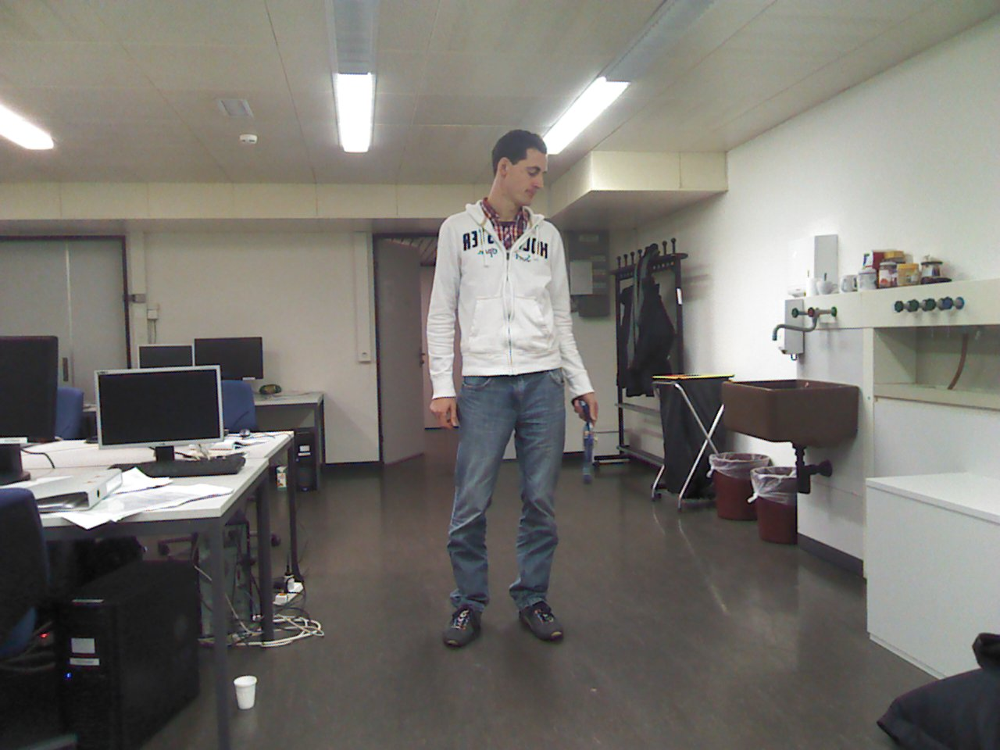

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 645.42307533  191.26197708  700.70274329  266.37723874    0.99994886]]


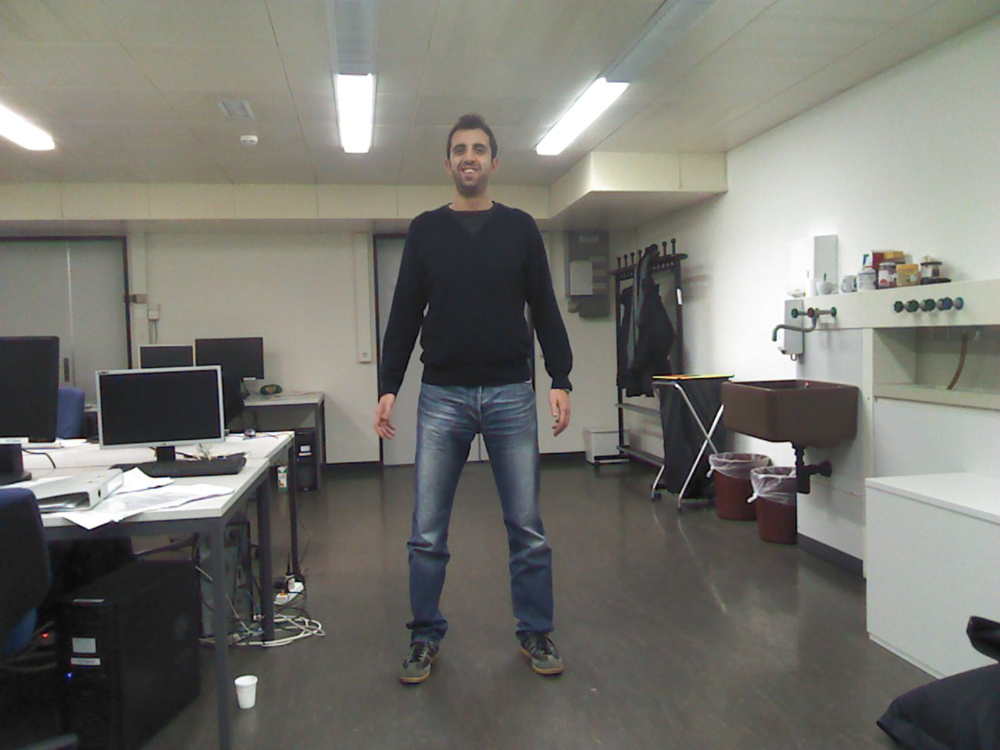

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 574.70916548  166.15296932  627.74112418  237.18765512    0.99997222]]


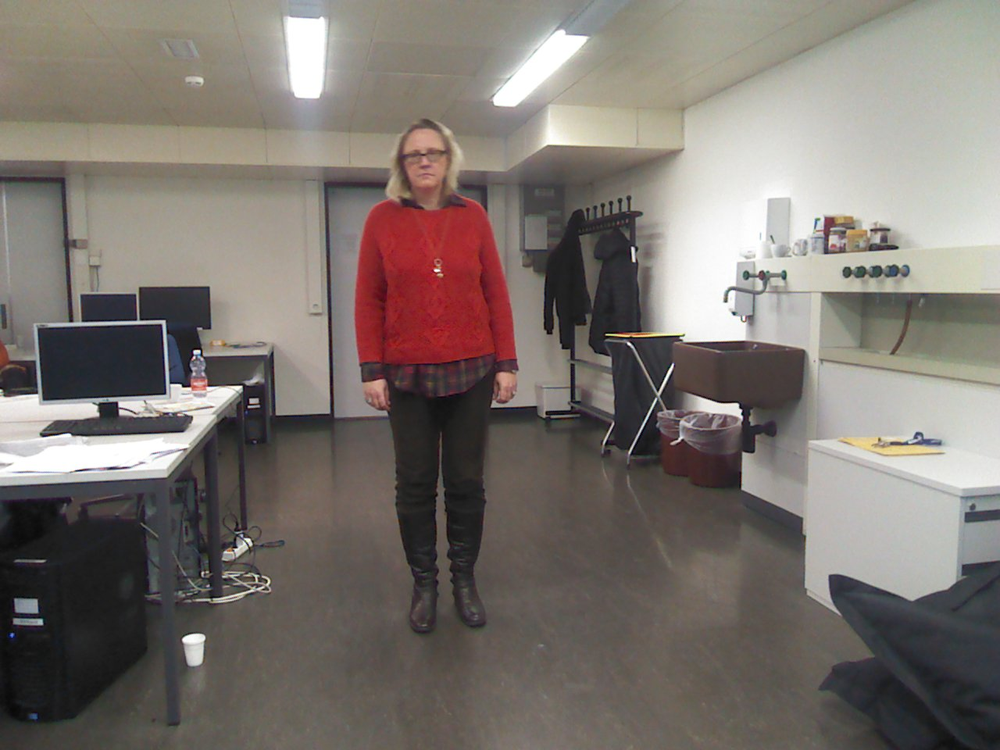

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 515.34217542  168.30120206  572.00575709  238.14200121    0.99899226]]


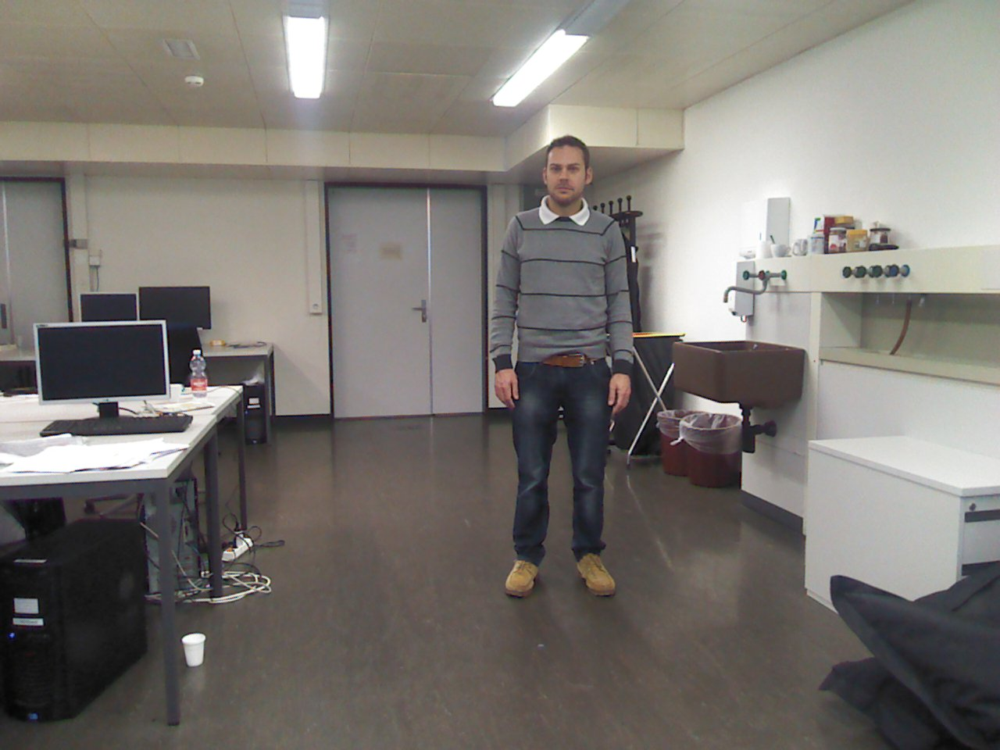

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 699.92558652  192.45572993  748.11353558  255.93640075    0.99999905]]


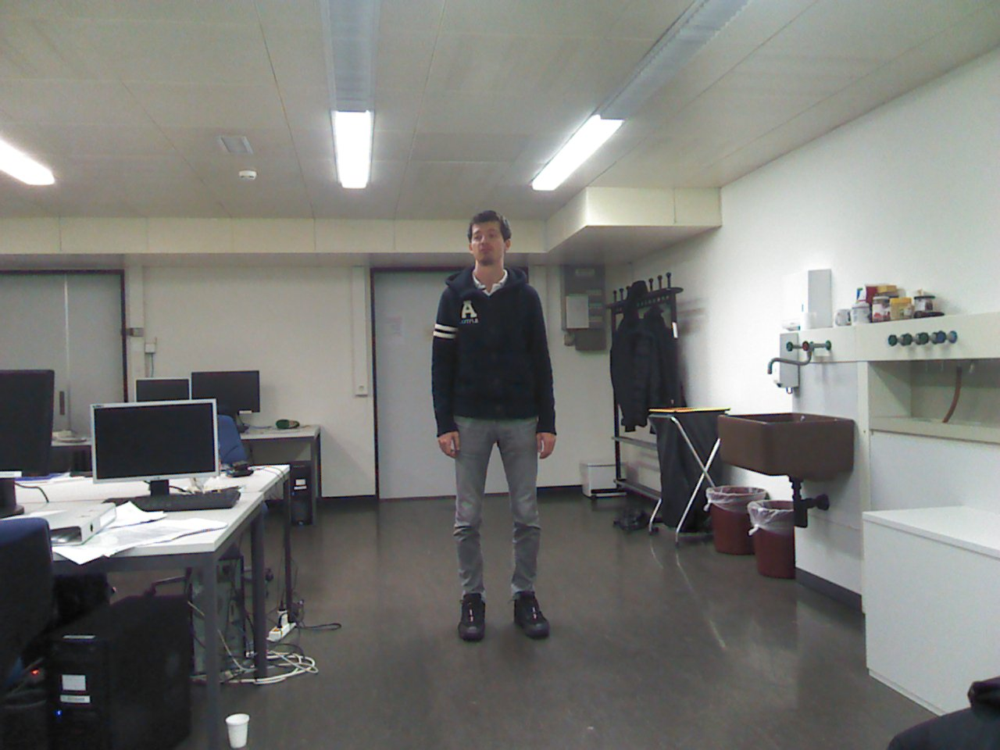

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 603.83834131  285.24926704  642.88353415  333.95885605    0.99952495]]


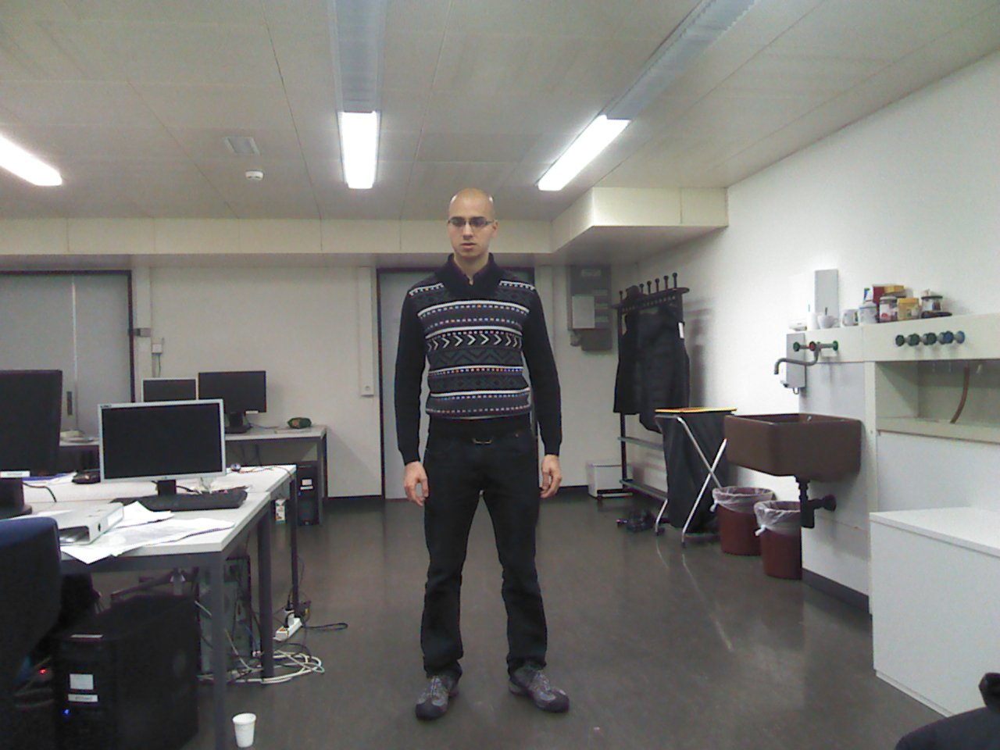

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 572.34666537  253.87880558  631.5193947   331.15928149    0.99999774]]


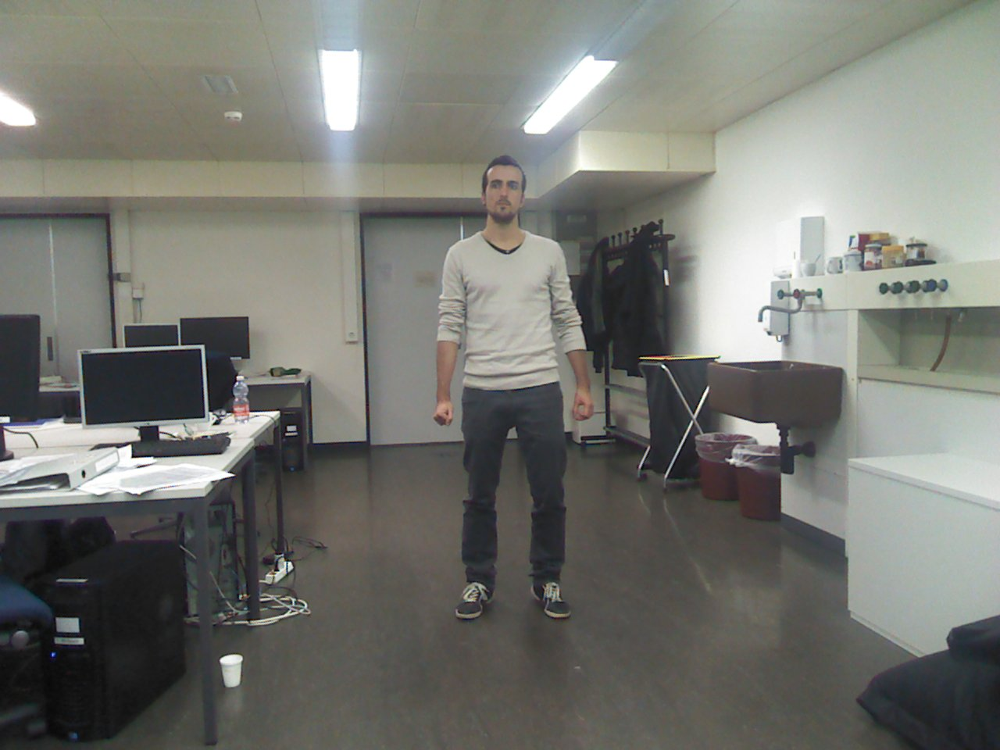

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 621.28611434  215.20790324  667.93112379  277.30655392    0.99995613]]


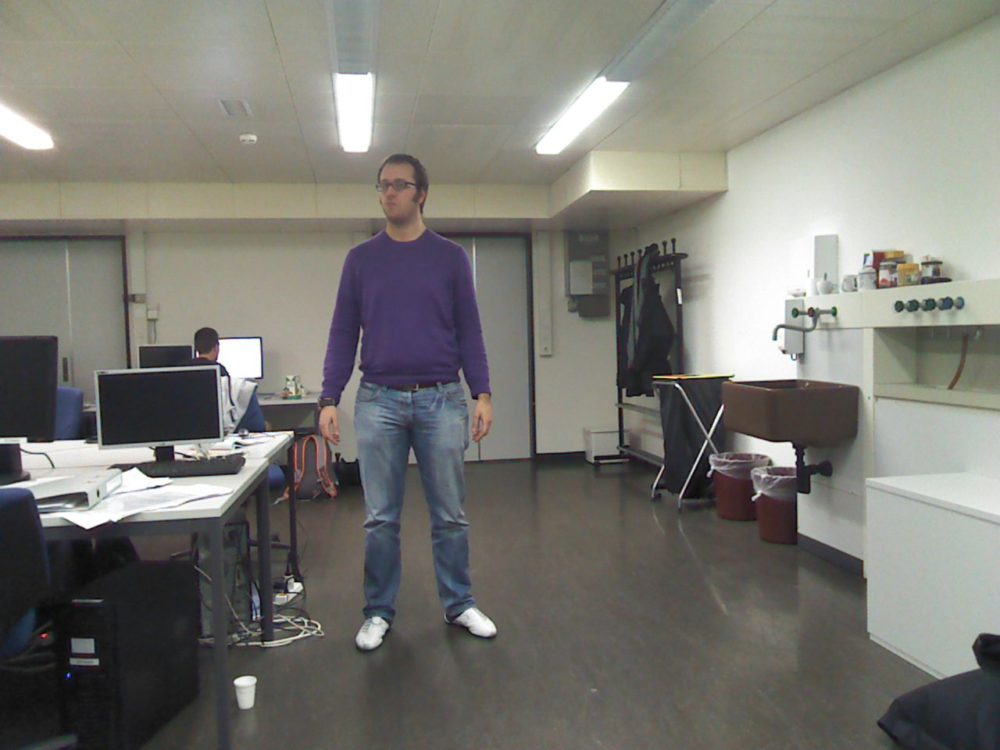

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 485.78922519  212.12125792  532.3852957   273.91667649    0.99961168]]


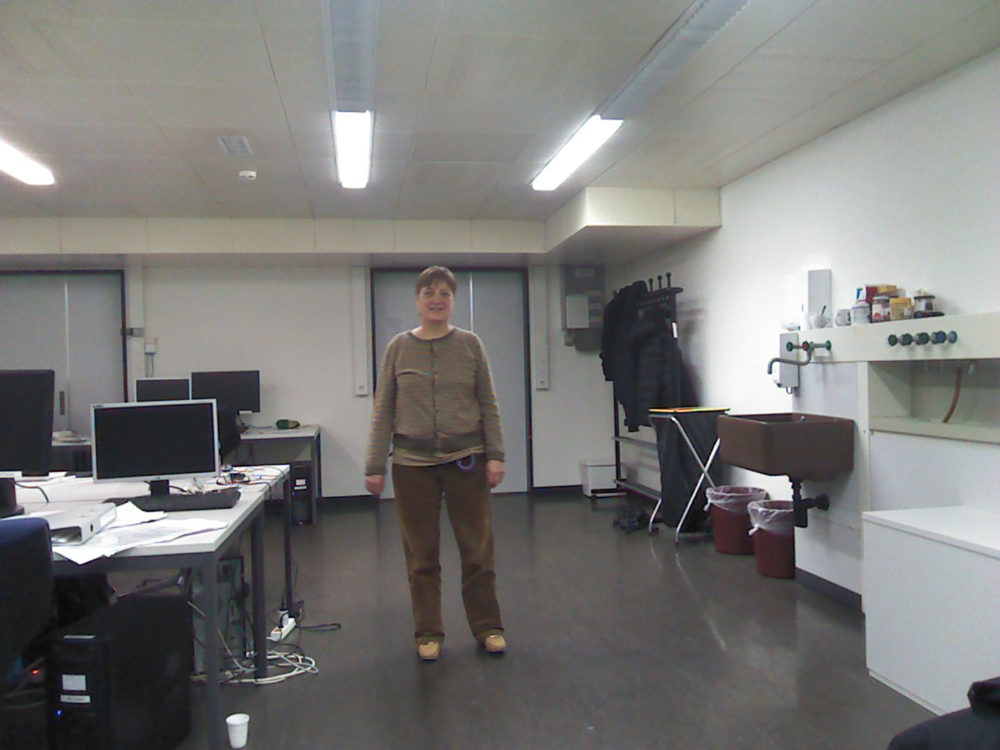

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 535.815816    357.17200592  578.82390204  410.13219247    0.99982685]]


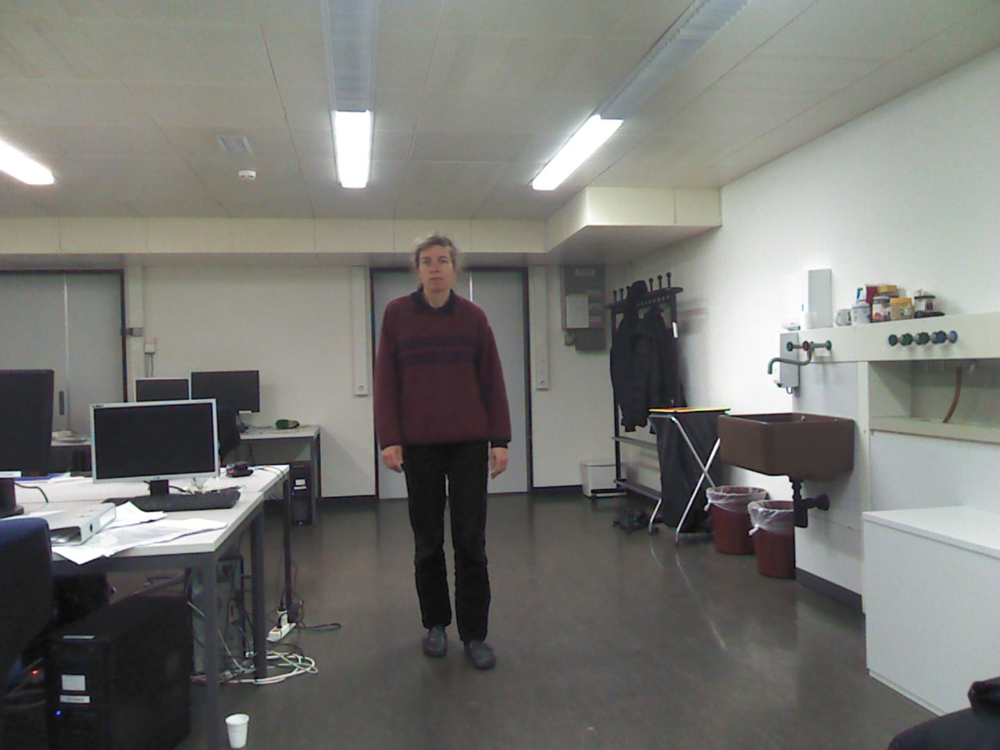

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 536.05984046  316.36144275  579.09396025  372.11866023    0.99773705]]


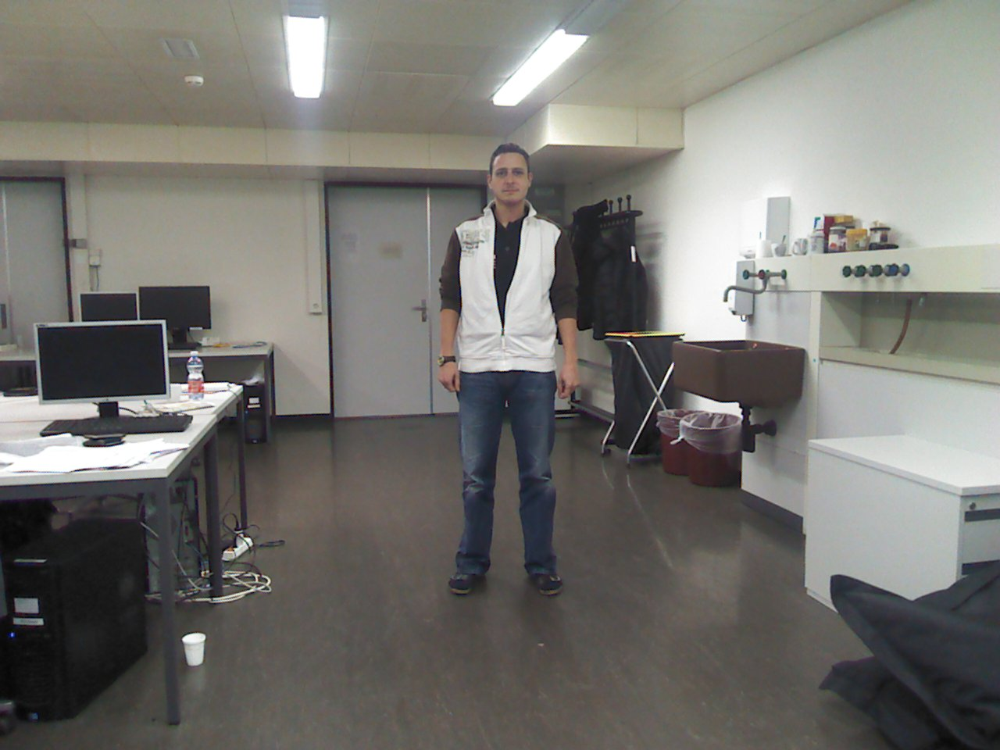

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 628.93563107  199.06239654  675.53880448  258.62319834    0.99993193]]


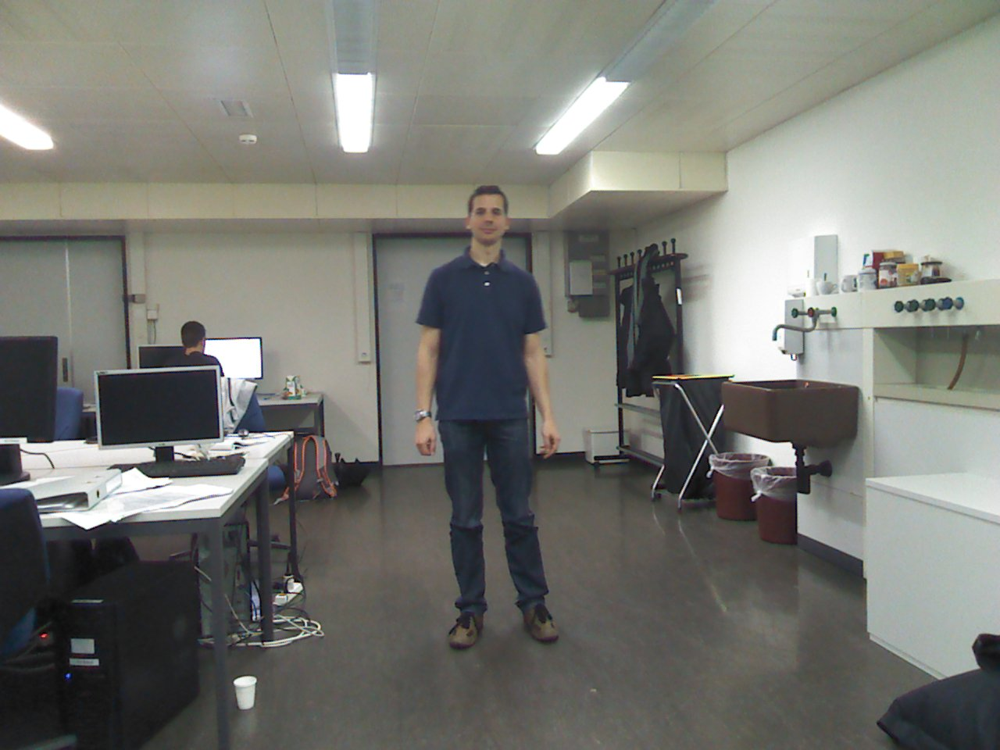

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 602.60474432  250.08038896  645.72596215  306.58370745    0.9999876 ]]


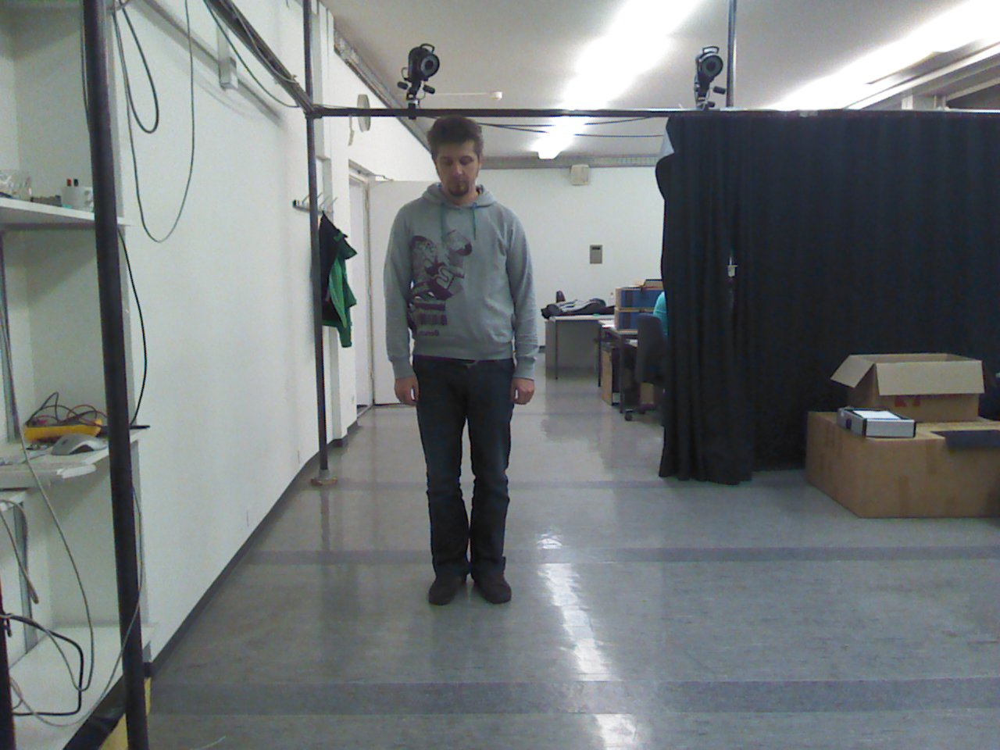

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 559.78487208  183.72232449  609.88308882  246.70338596    0.99996817]]


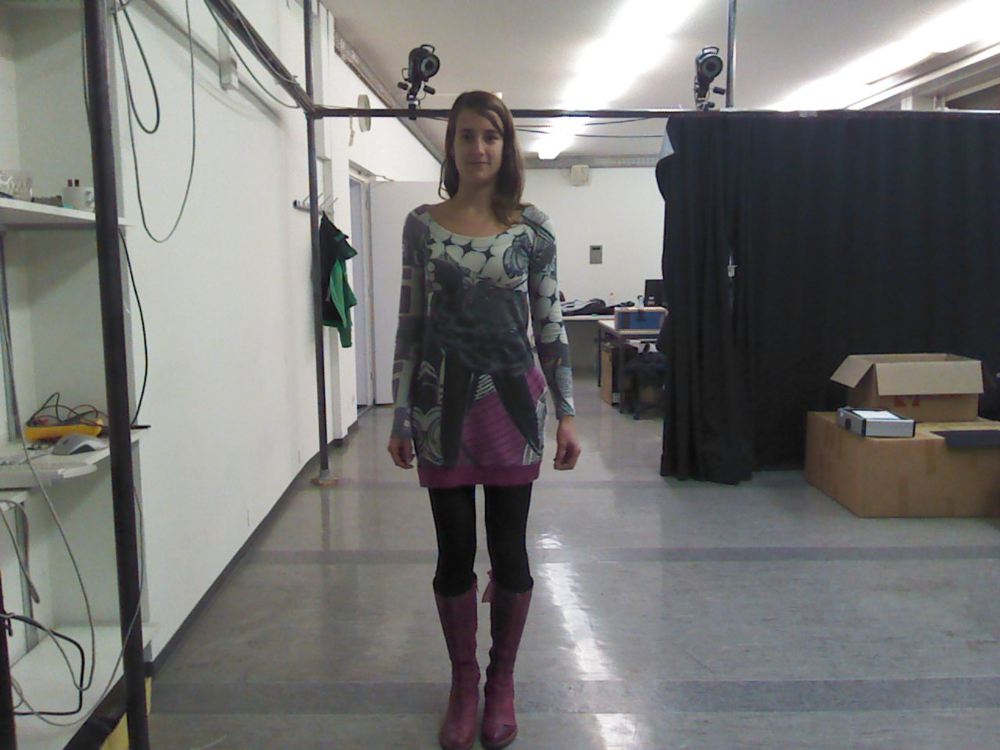

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 579.37139745  142.23151822  643.52843719  227.65820061    0.99999666]]


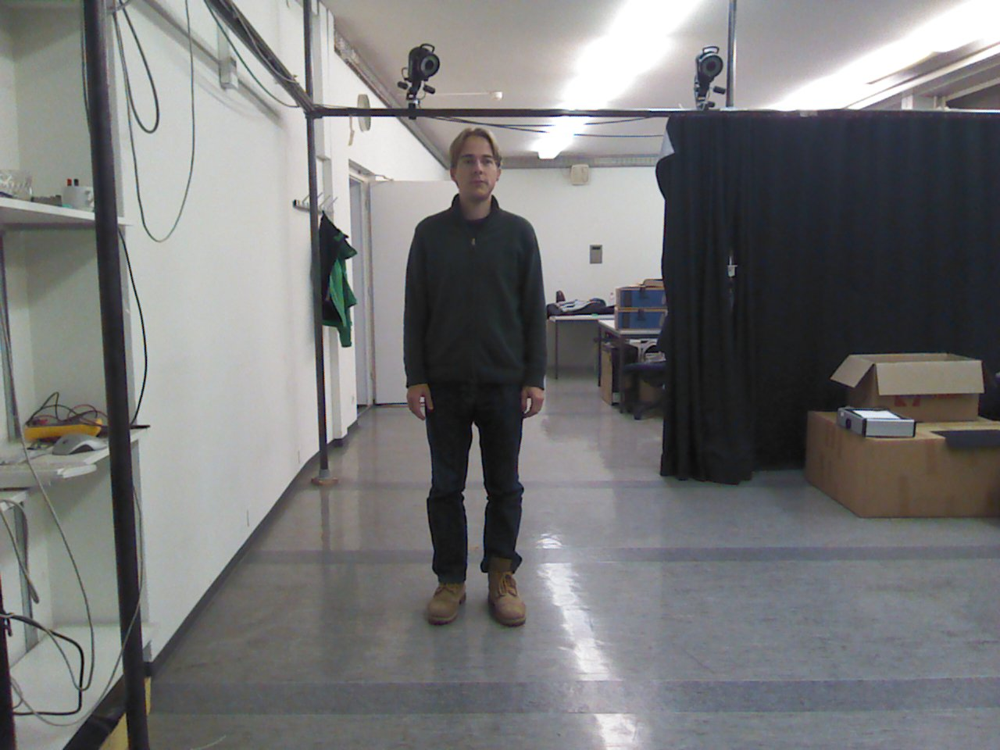

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 582.31385224  181.74859391  633.78542456  247.54930104    0.99999714]]


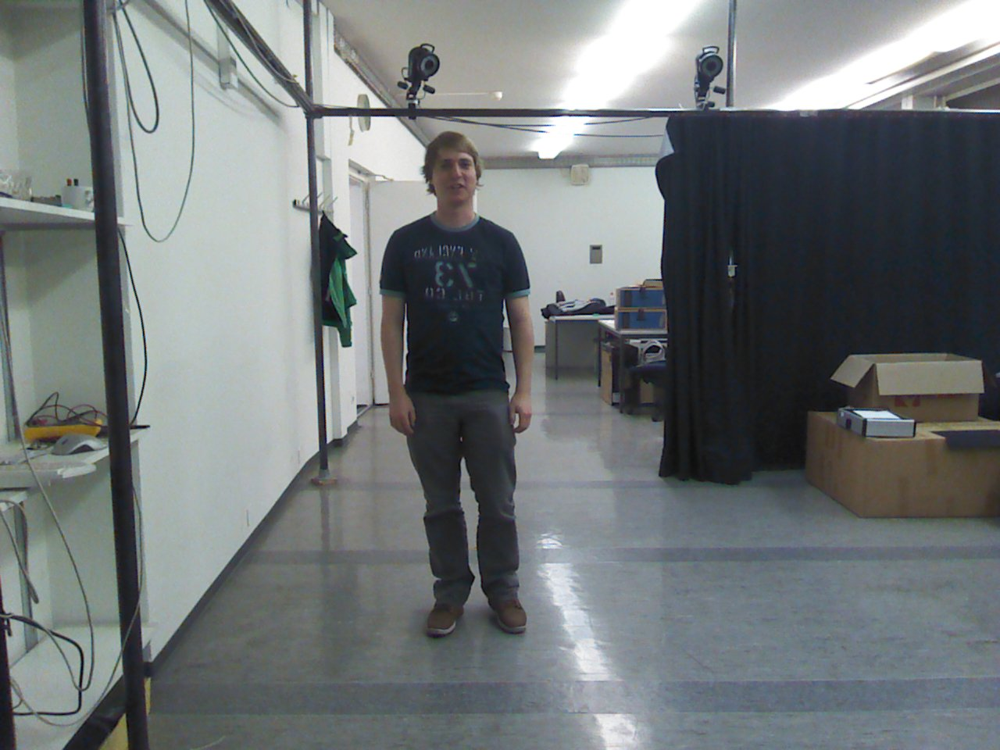

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 553.84757137  187.01595306  607.32608509  255.9298116     0.99999416]]


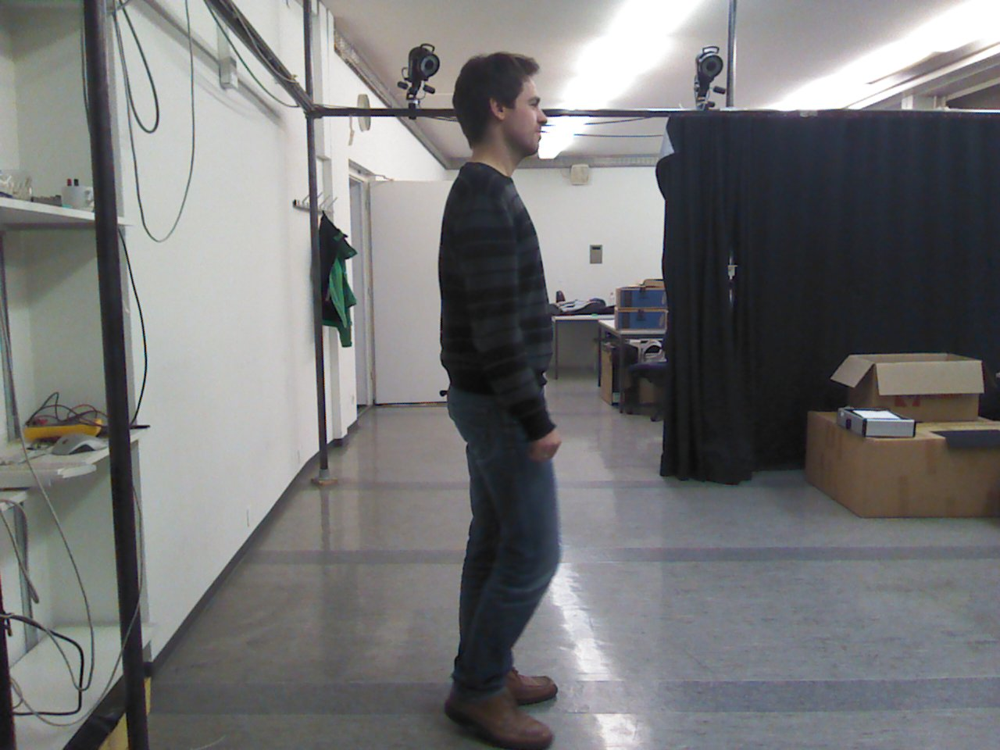

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 647.87817706   99.03030837  698.80014923  189.30134891    0.99994981]]


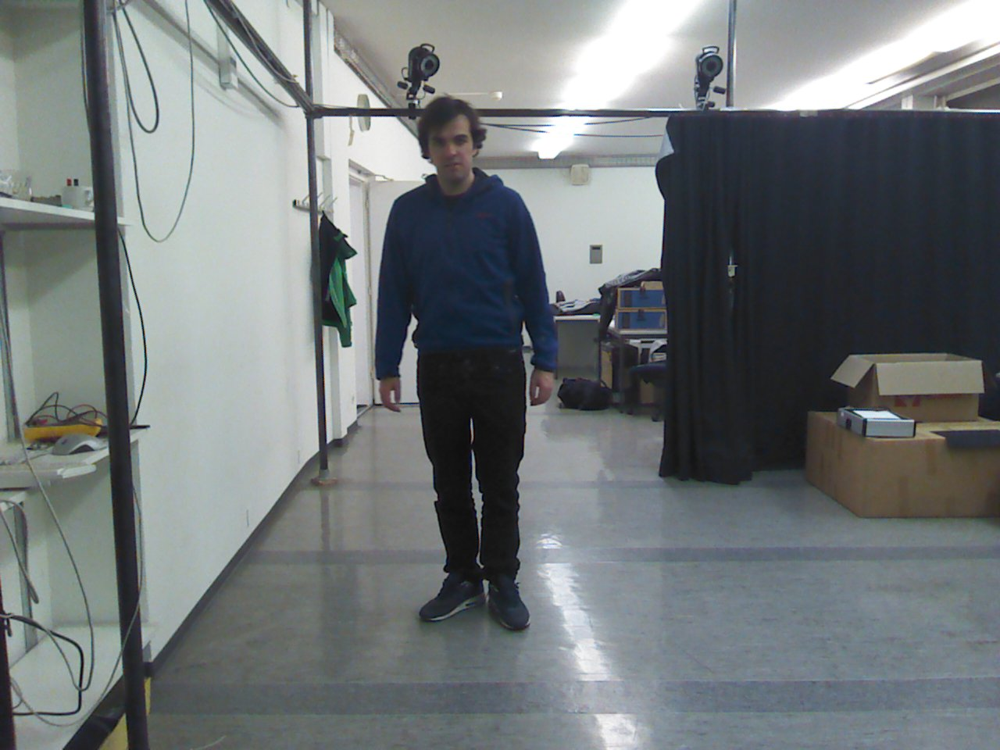

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 548.42216188  154.82741639  604.83265726  226.2529178     0.99990332]]


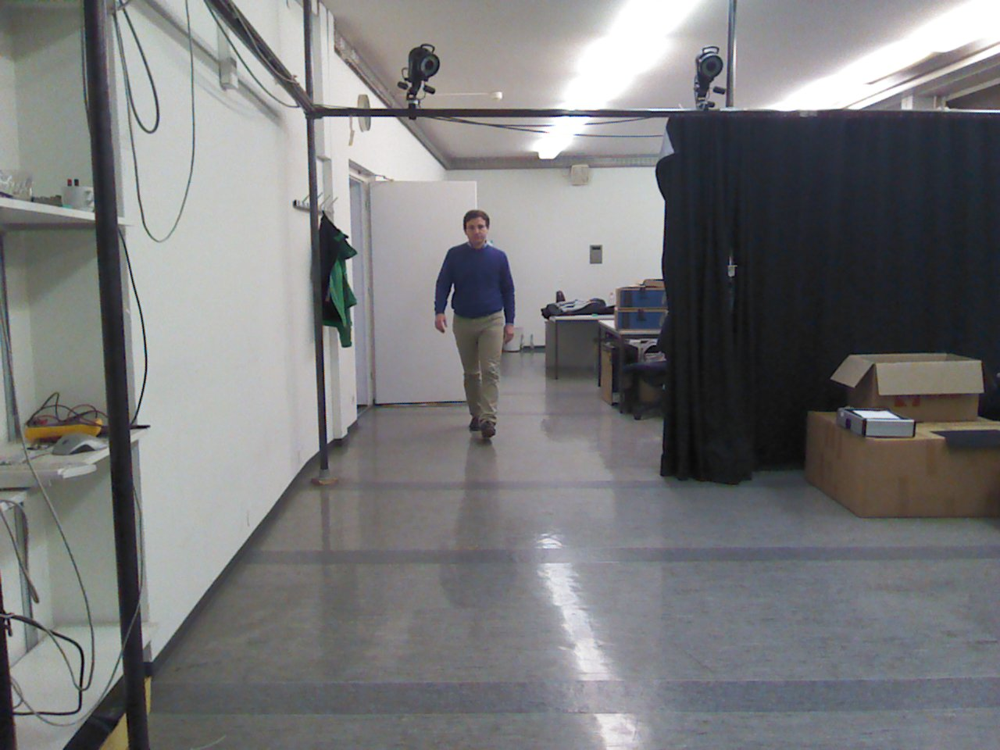

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 597.07206433  279.07761258  621.31185594  310.39993954    0.99996531]]


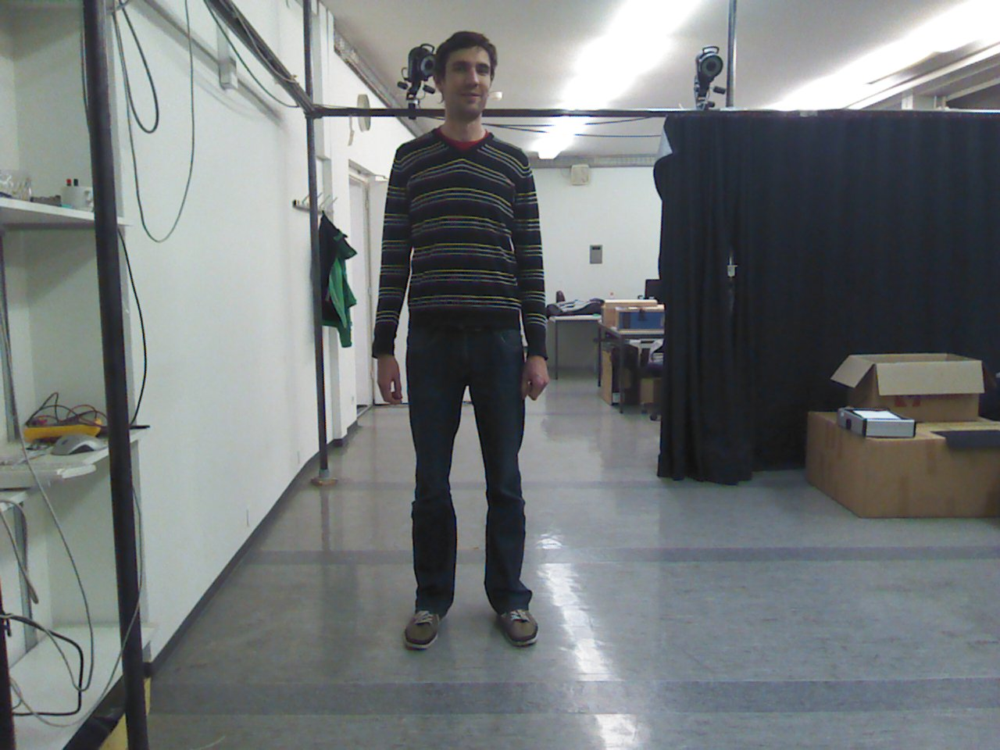

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 566.97231124   59.90277581  628.31778604  140.41299875    0.99998653]]


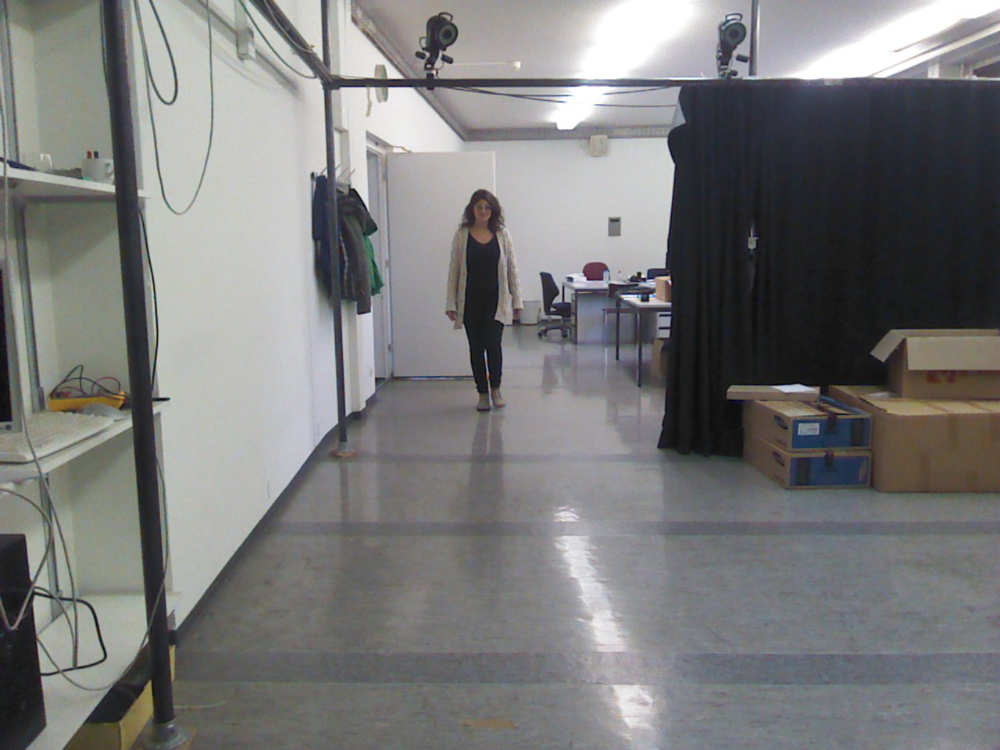

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 607.27897125  255.82602459  626.36026473  281.45000767    0.98789304]]


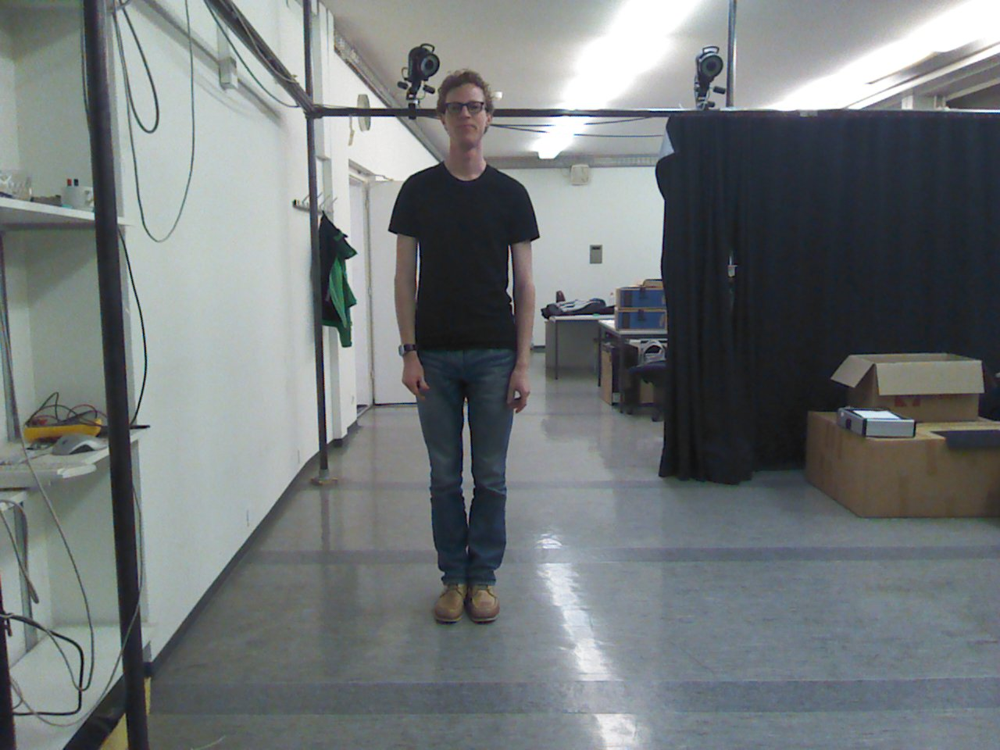

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 569.44997384  112.64357035  619.39385298  176.16869743    0.99996686]]


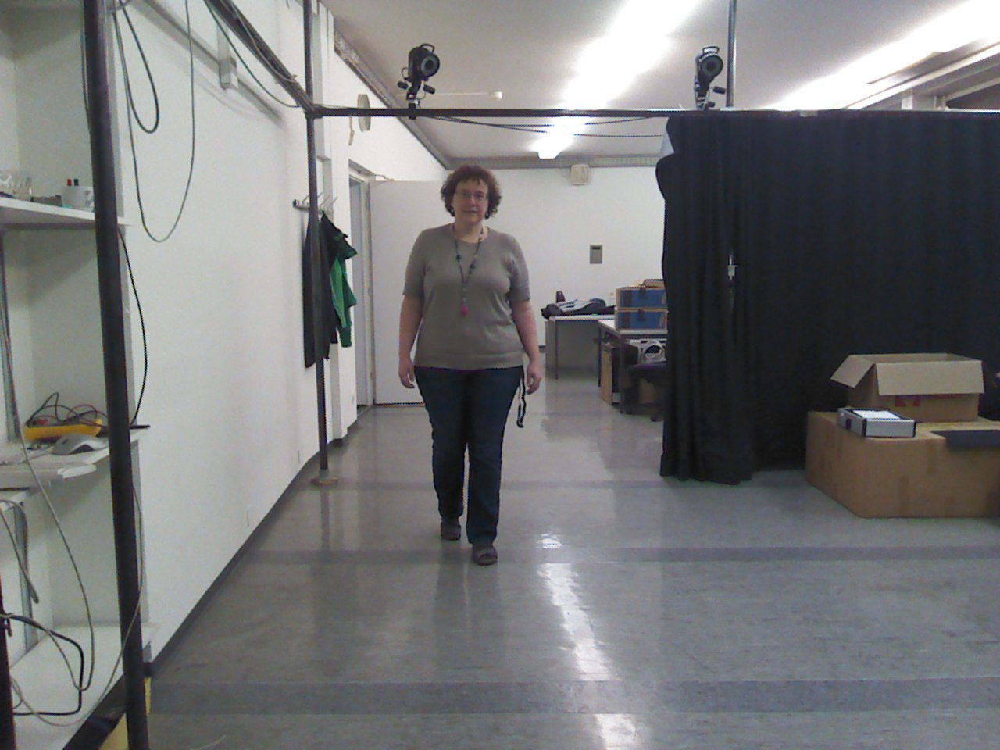

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 581.27697973  231.13908406  621.80618376  282.94000689    0.99998891]]


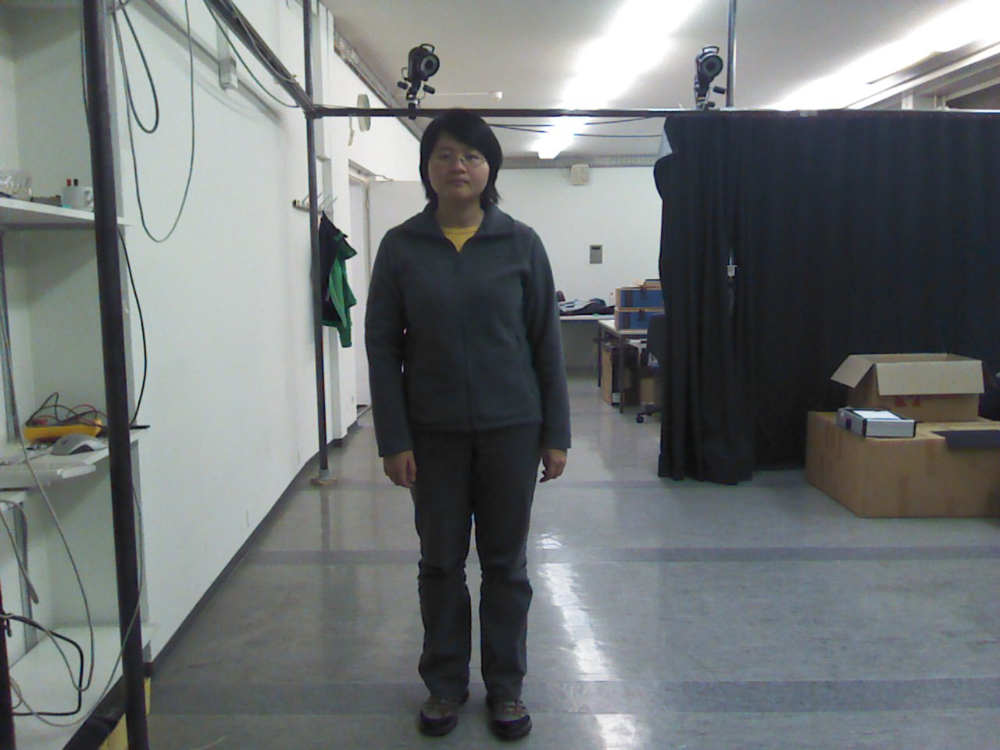

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 552.03974859  173.7281656   622.98394564  253.67258347    0.99997783]]


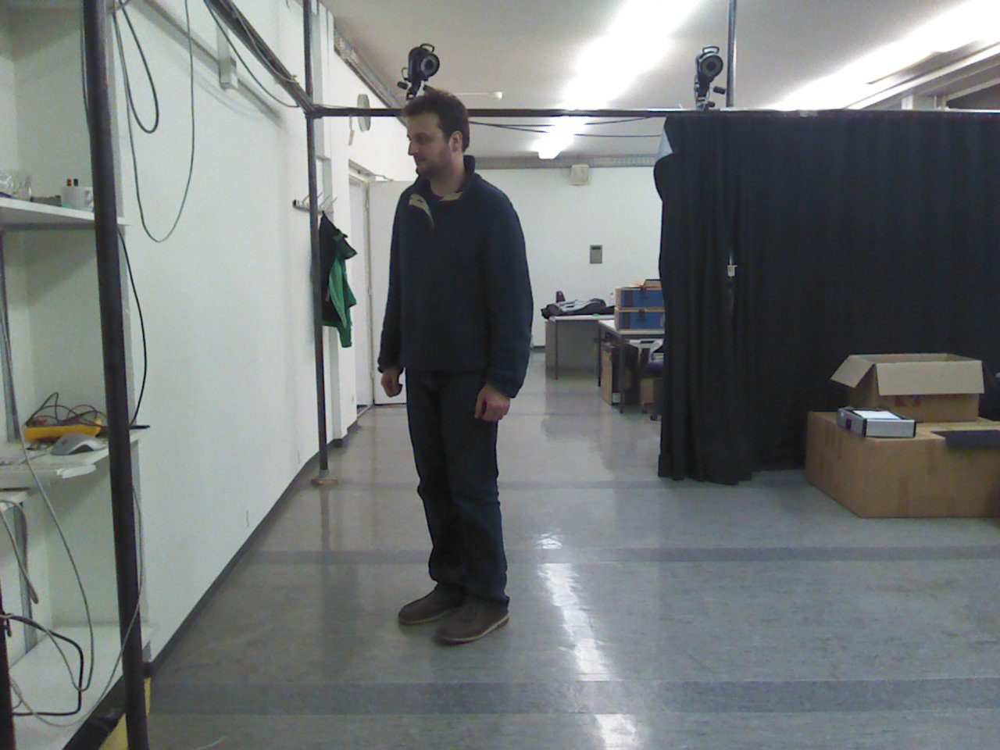

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 516.94682688  147.87001066  571.38973355  221.32544941    0.99998391]]


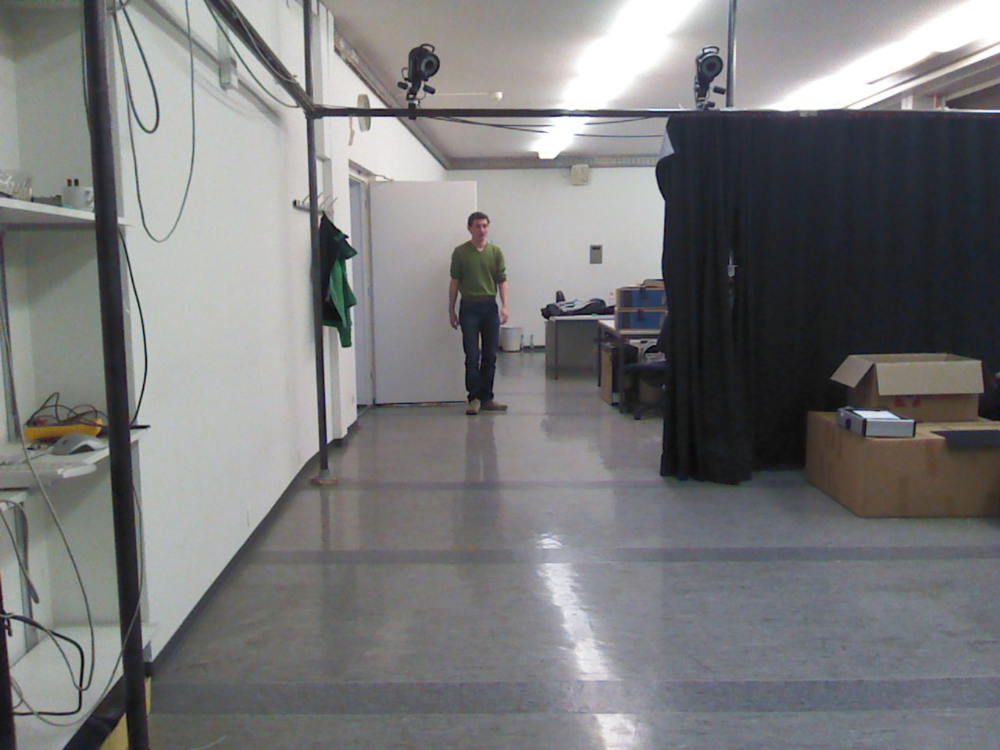

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 604.03843188  280.2723813   623.44081807  306.13727925    0.99977905]]


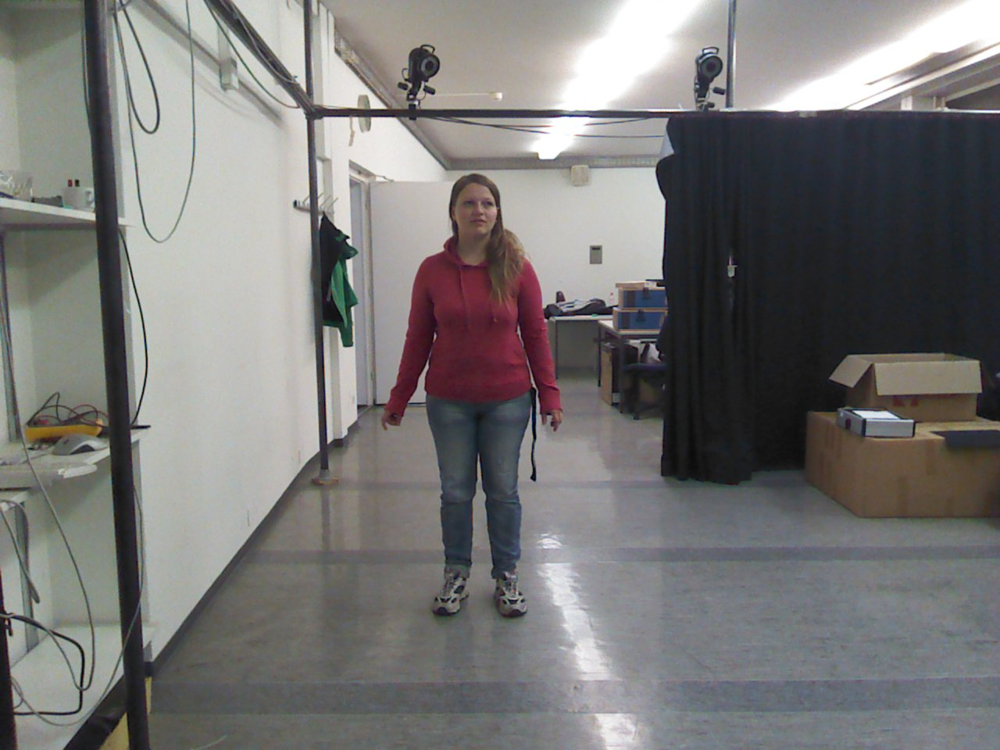

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 584.13401389  236.2000301   633.60245961  298.98979229    0.99999893]]


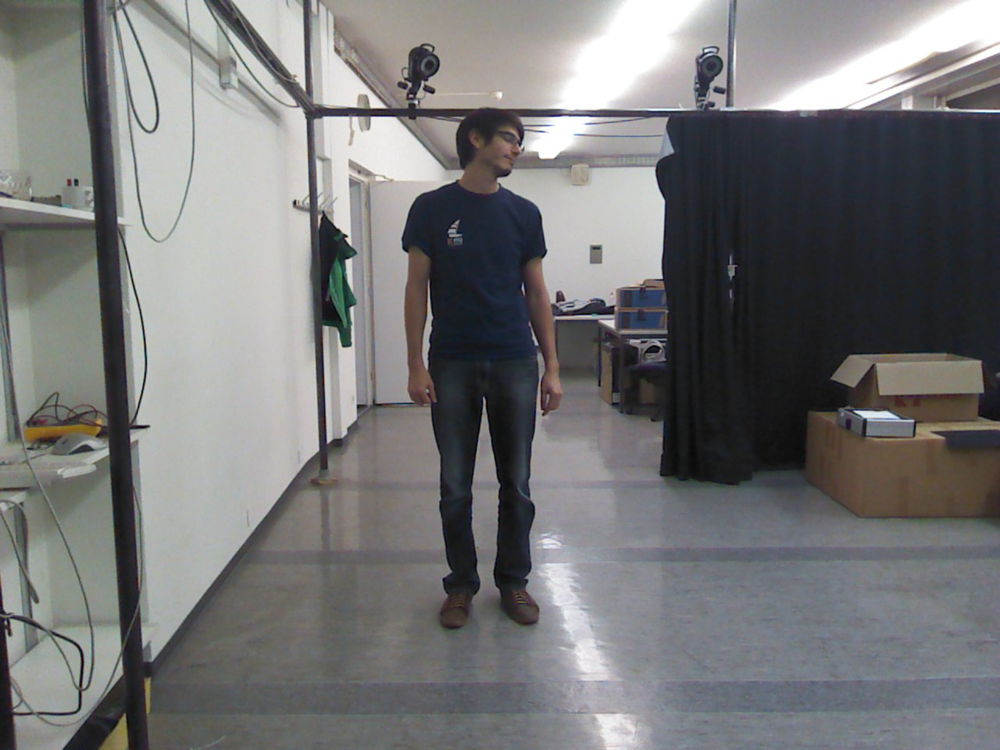

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 622.17736436  154.84531882  668.18476298  218.87571082    0.99848098]]


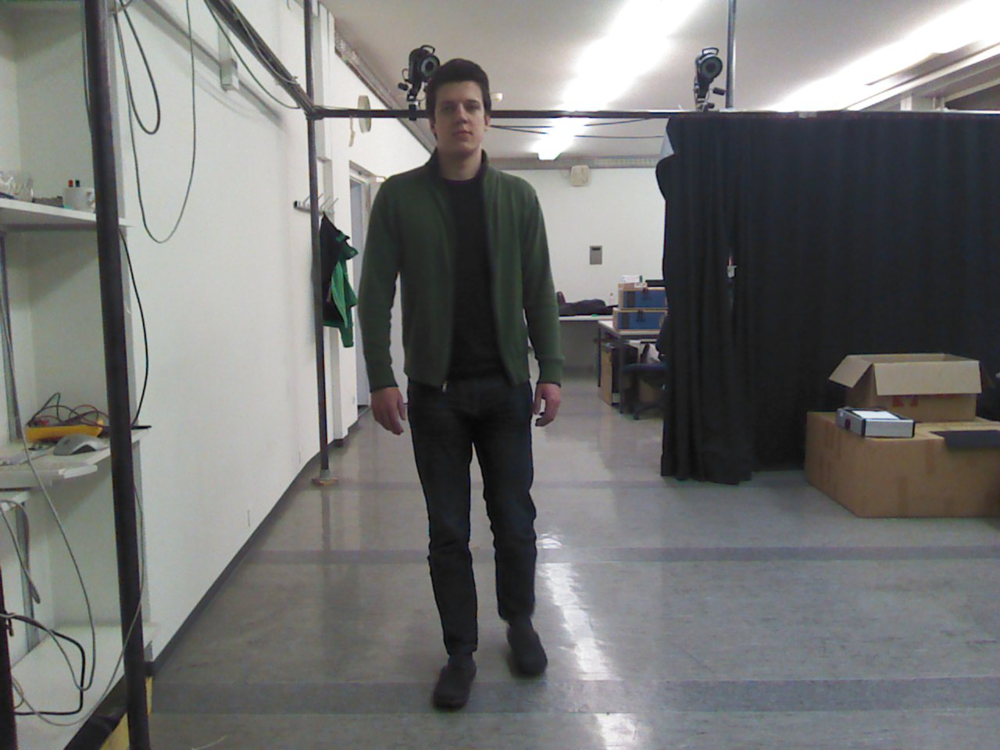

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 556.04946738  107.02937898  619.49067849  188.68882325    0.99995553]]


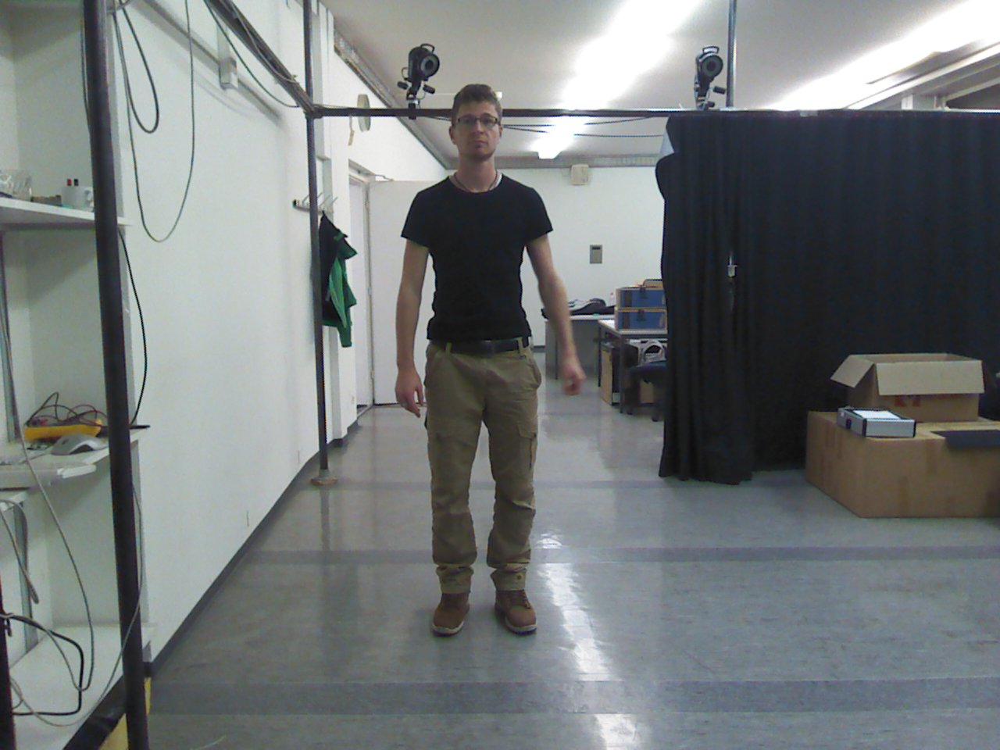

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 583.62729572  131.17047948  637.07648183  199.15739648    0.99999416]]


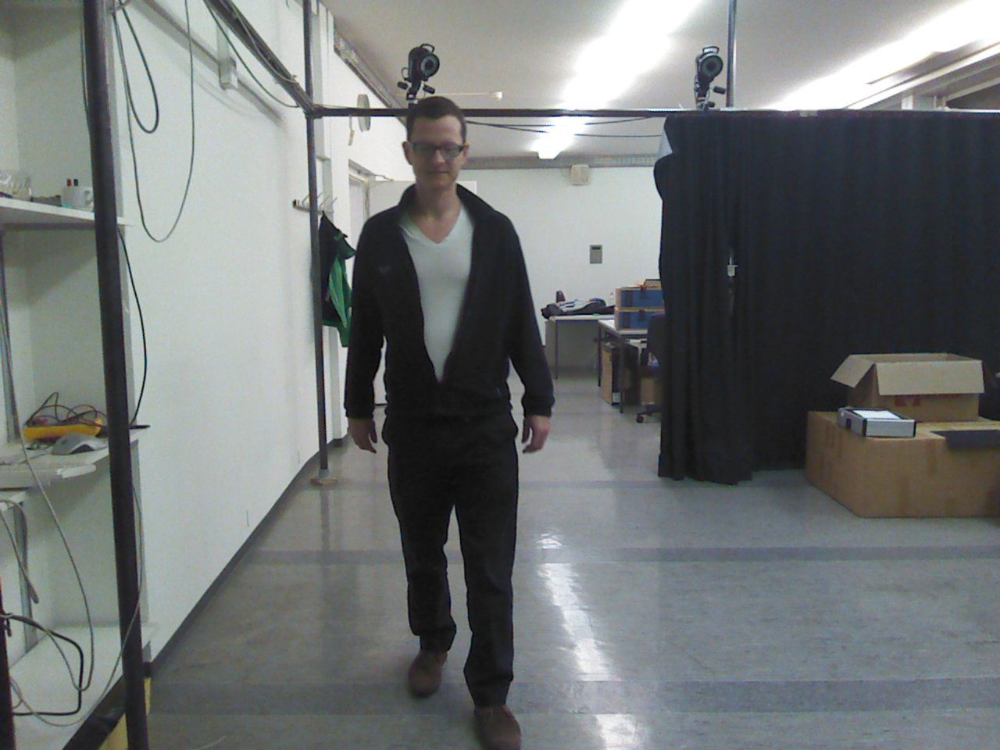

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 526.25598472  156.38065819  590.29211038  239.4974542     0.99996257]]


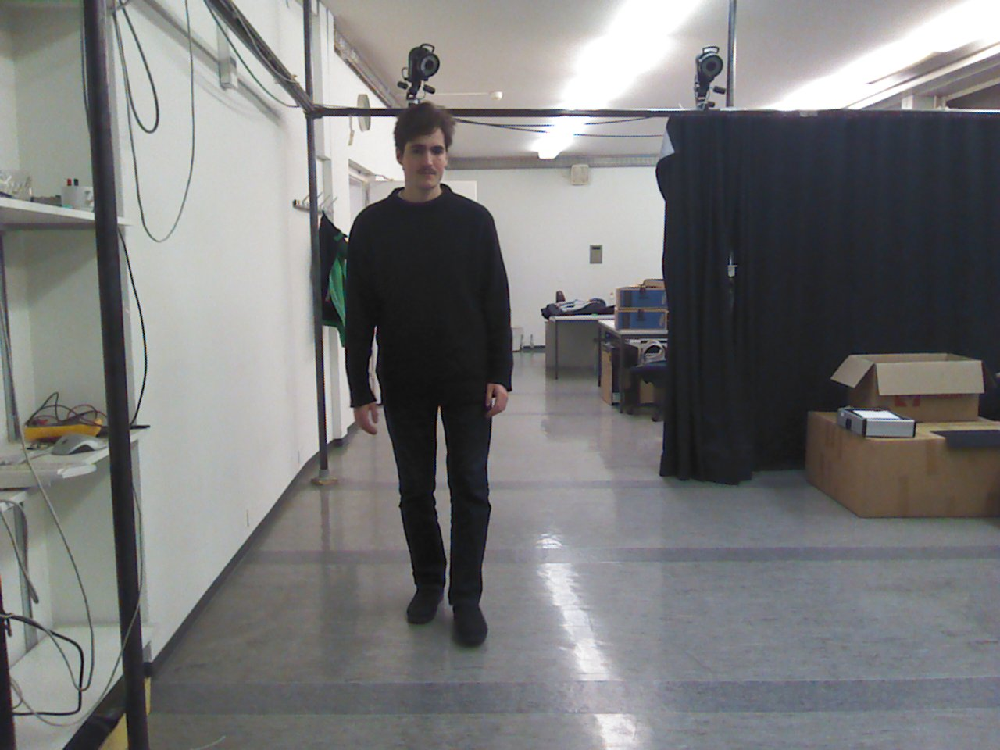

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 514.89842725  168.30680183  569.00328708  236.12110651    0.99996412]]


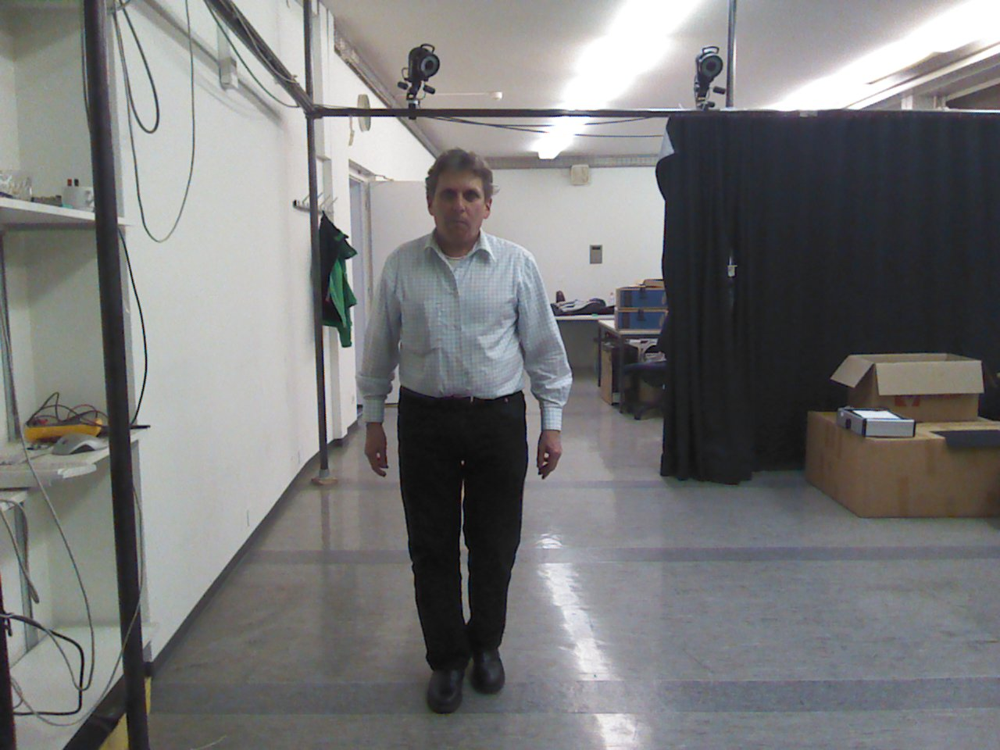

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 553.99455422  219.54707208  617.72993541  301.7377527     0.99999225]]


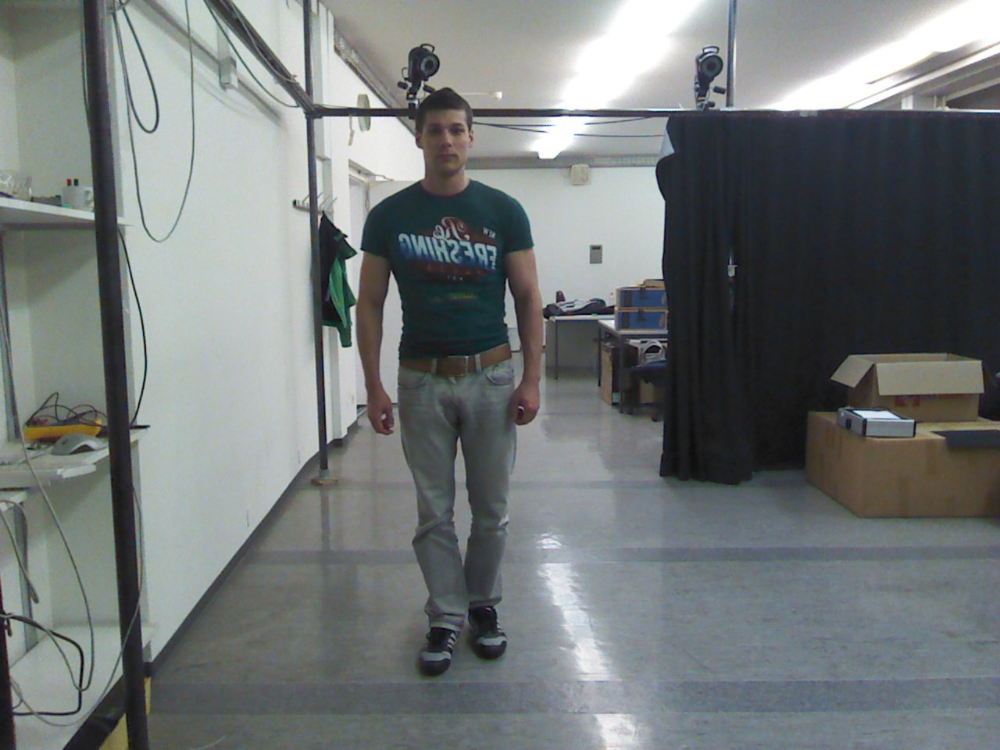

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 538.12357113  136.49635187  599.42686874  215.41976234    0.99999201]]


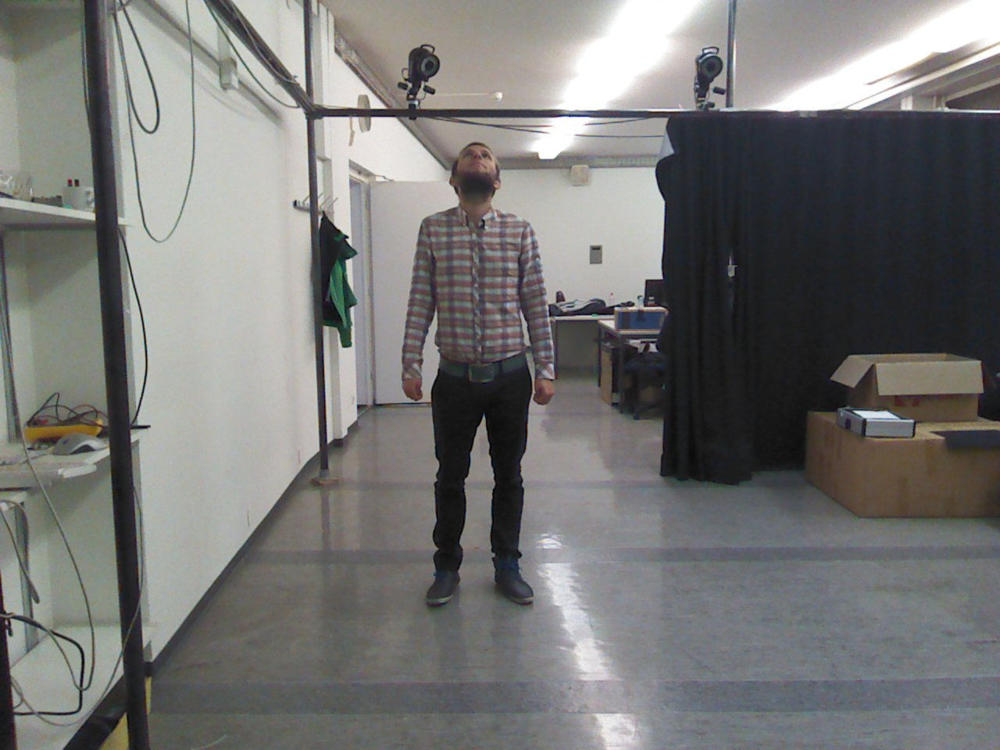

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 601.93990397  244.37133741  629.93391752  282.99332047    0.75813967]]


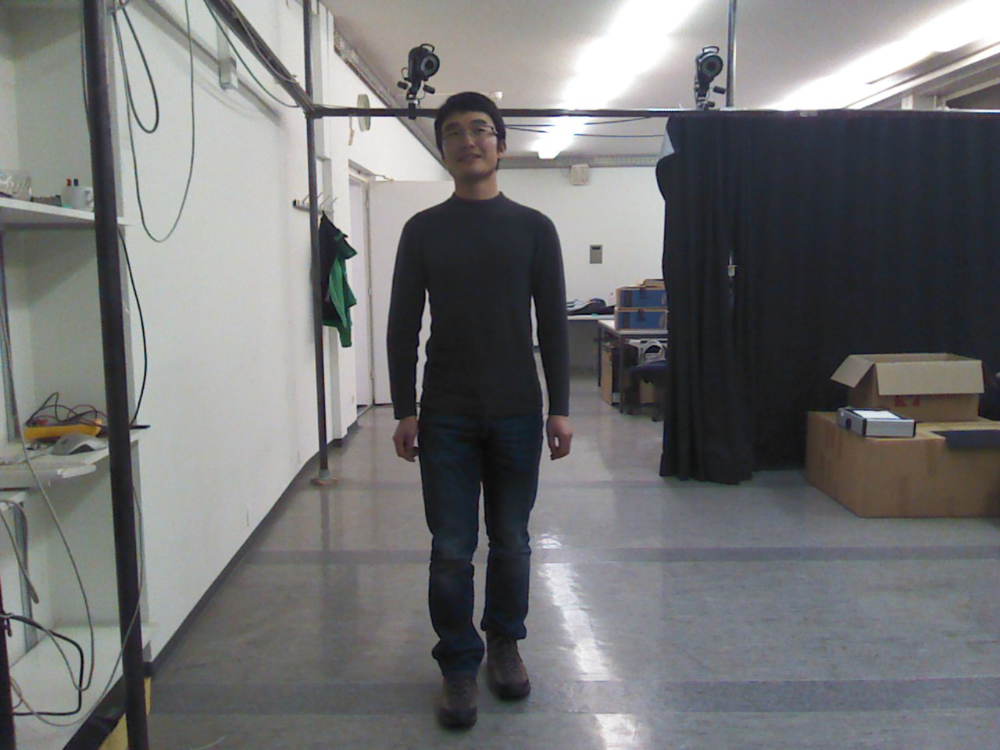

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 564.98244374  137.08046263  634.68471563  220.63390411    0.99999142]]


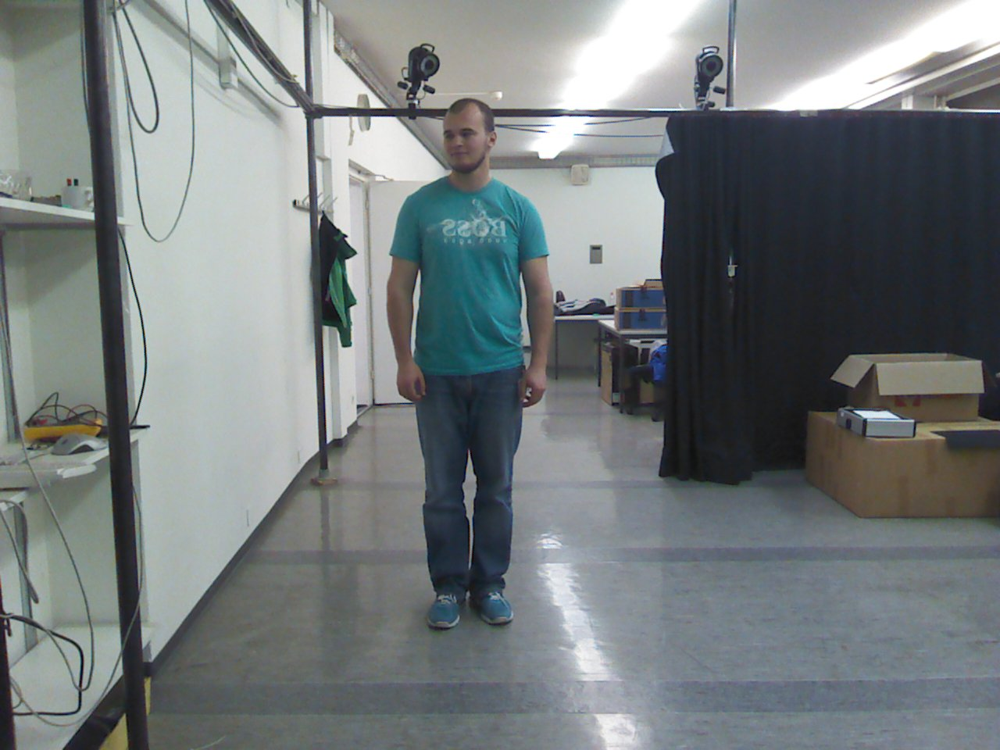

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 564.35651062  145.13804115  619.60466483  211.0592175     0.999951  ]]


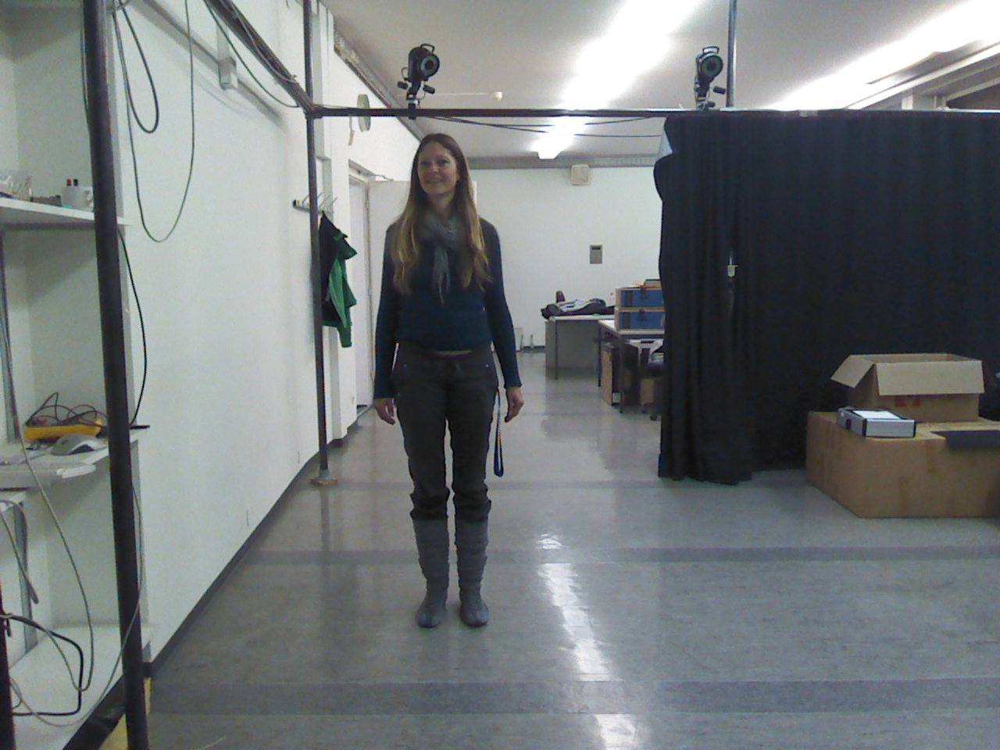

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 535.26330304  186.2322394   582.7773445   245.29728109    0.99983978]]


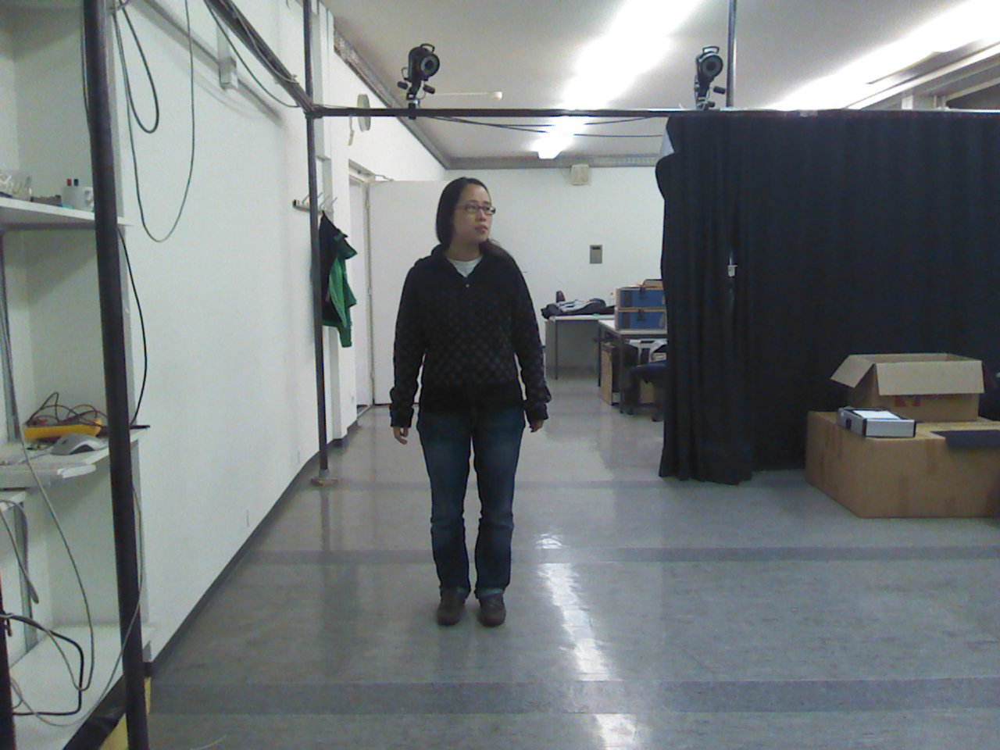

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 582.93964881  243.4408977   630.93257557  308.19660851    0.99991512]]


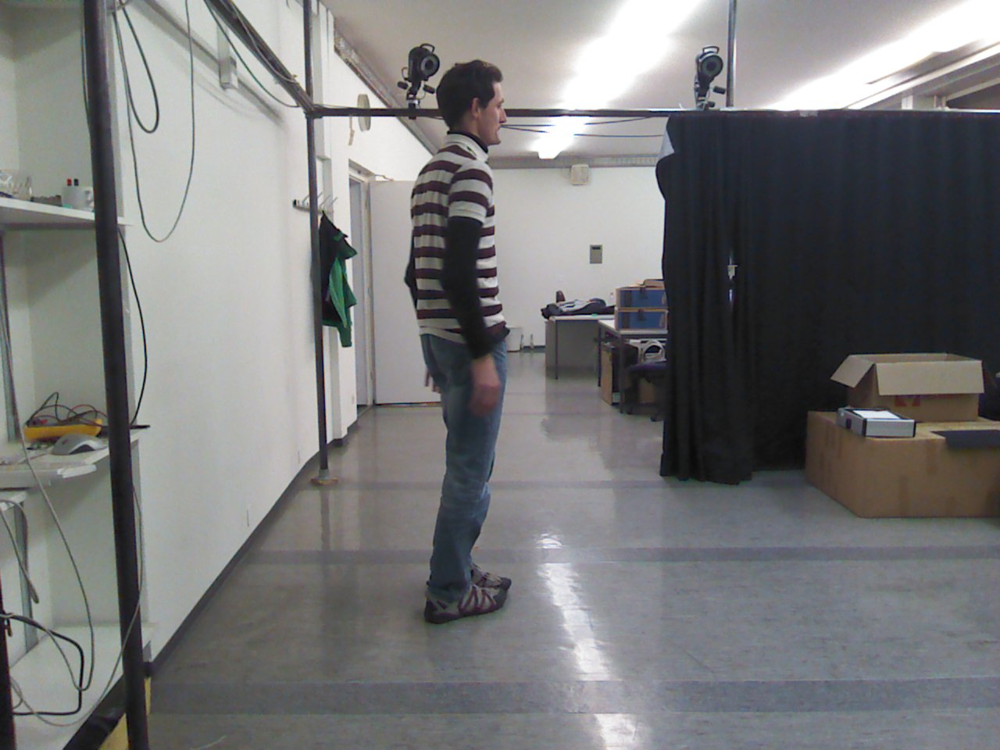

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 609.9785347   108.2717729   647.10811043  177.48126724    0.99798942]]


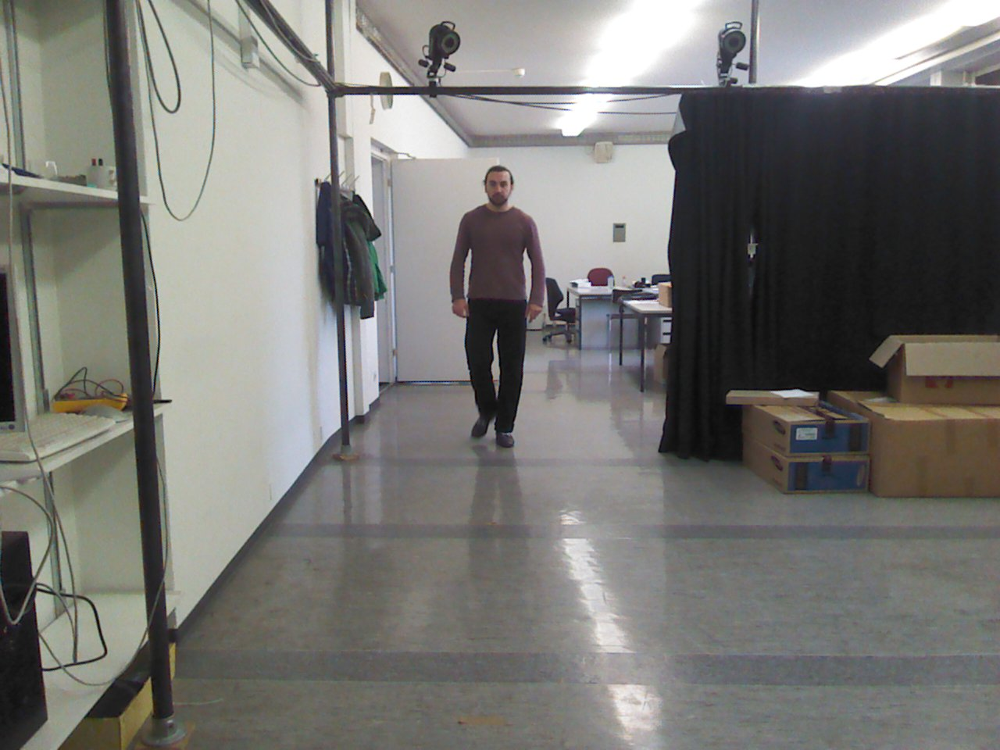

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 622.17938583  218.96440613  652.33996692  259.79998855    0.99998963]]


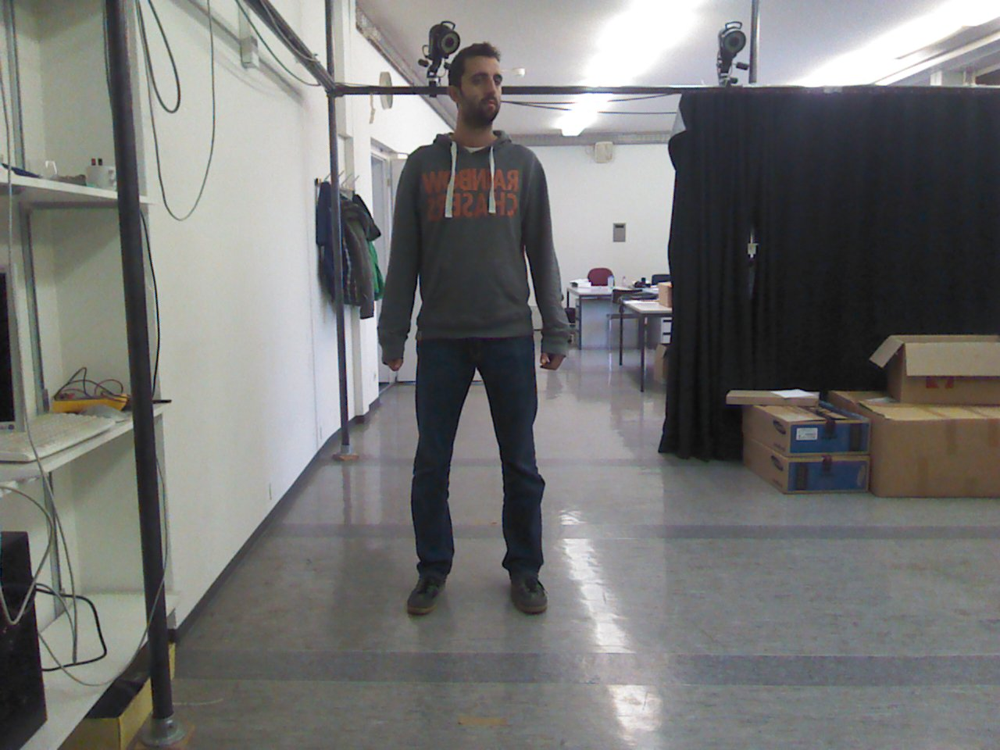

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 585.73246199   72.71837315  645.67251229  151.35415792    0.99990439]]


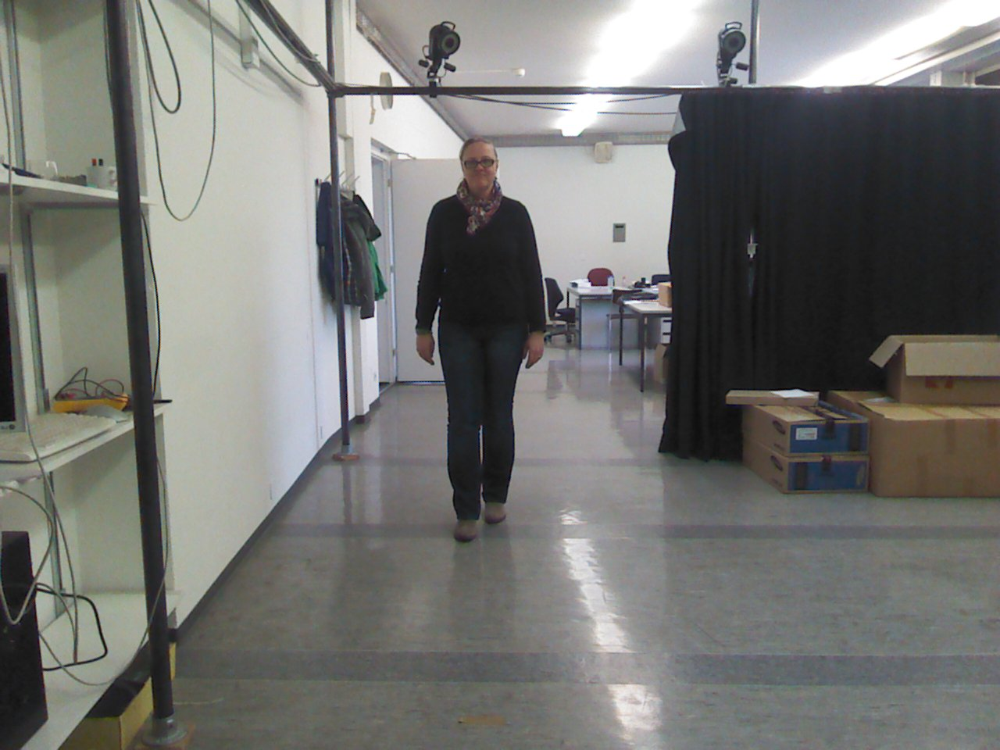

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 592.35128967  186.47073042  633.1344844   241.16102981    0.99981588]]


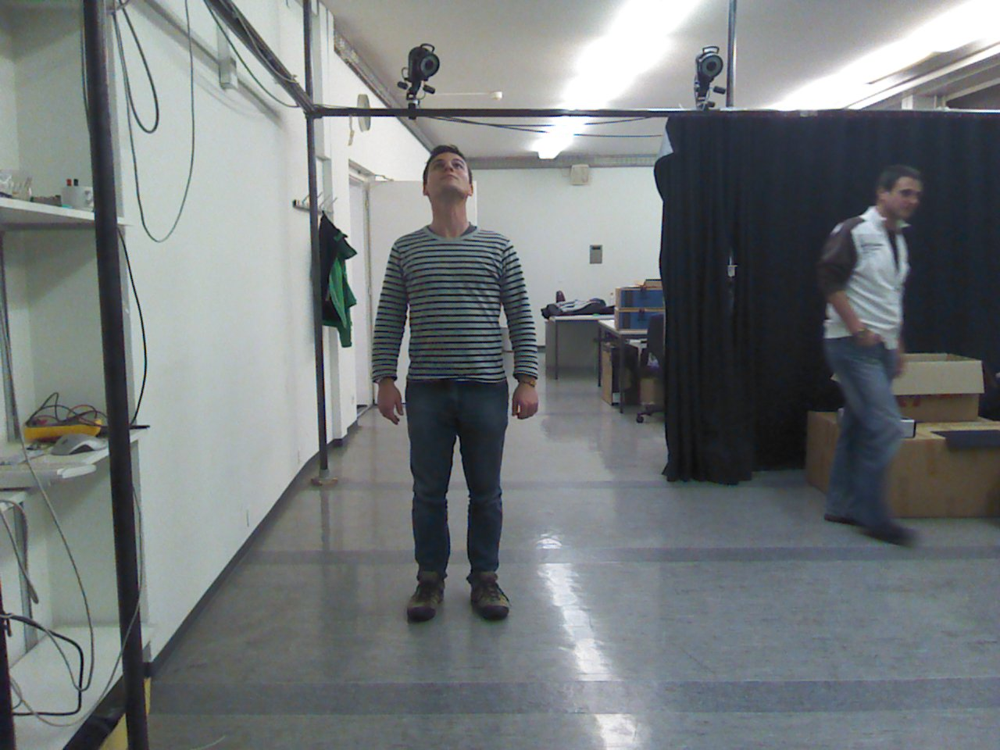

('paaath : ', <type 'numpy.string_'>)
the bbs [[  1.13823354e+03   2.27276665e+02   1.17633941e+03   2.78343778e+02
    9.99562562e-01]
 [  5.49320647e+02   1.92553572e+02   6.00212820e+02   2.54222779e+02
    9.73365068e-01]]


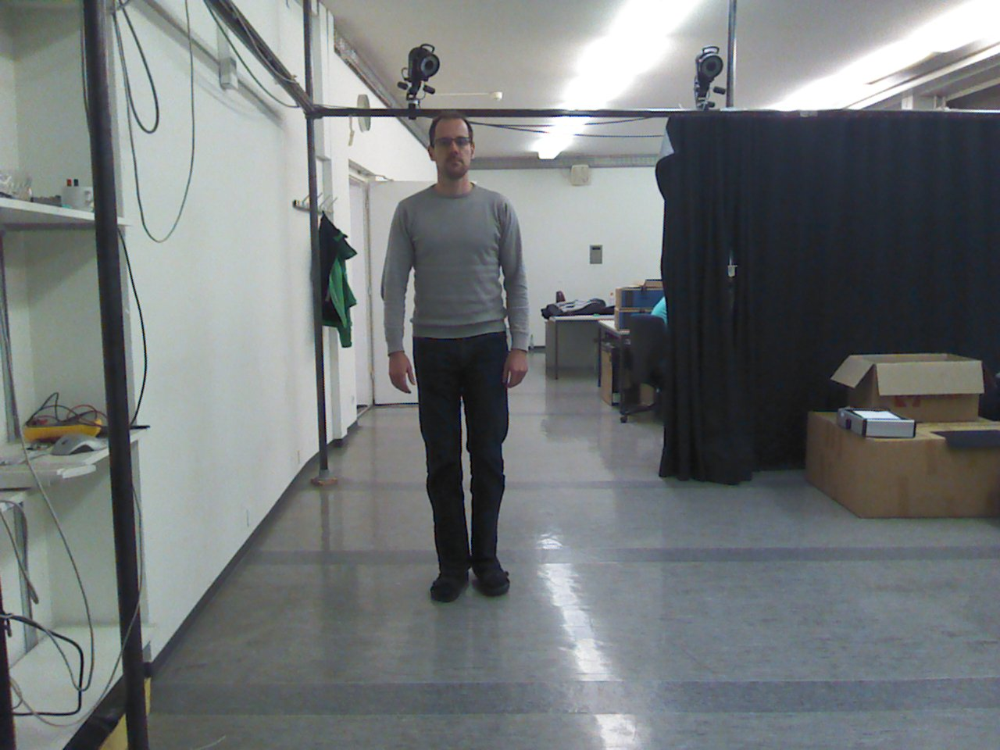

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 556.7034114   161.7692599   601.89355354  221.43365098    0.99997509]]


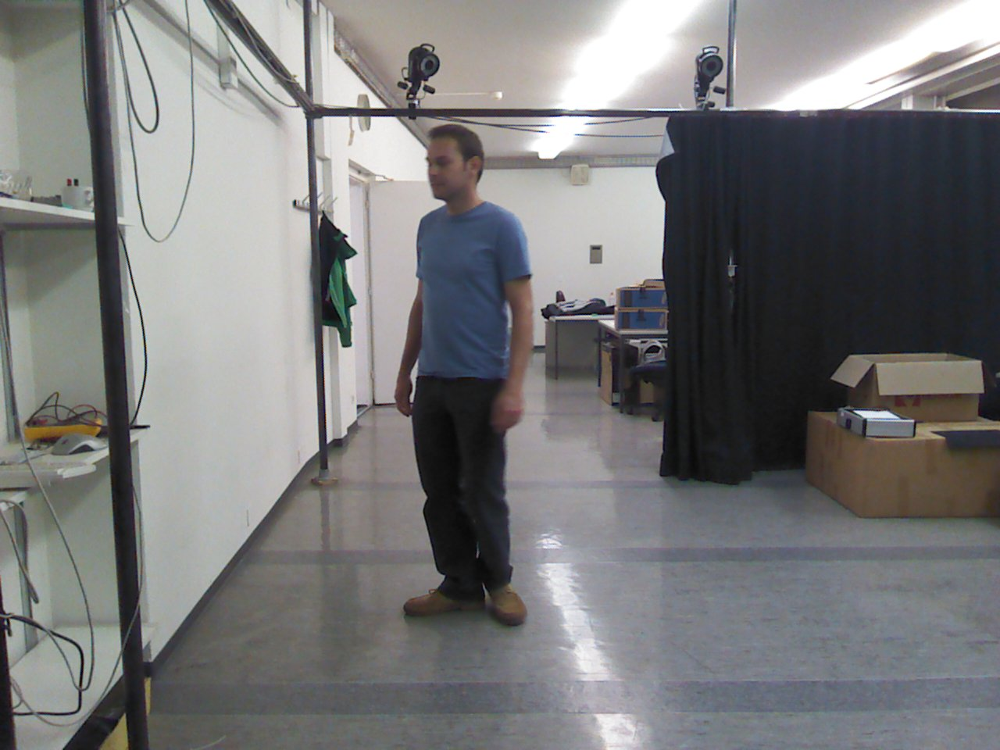

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 541.33708808  176.90243892  594.01612014  251.15806171    0.99998403]]


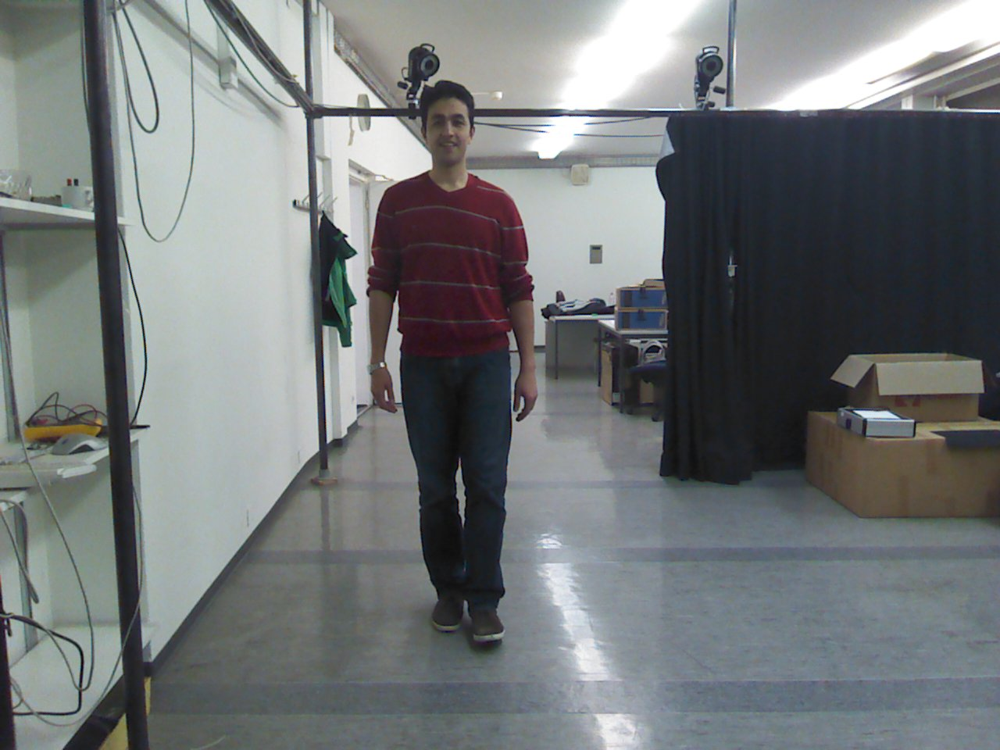

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 541.78897798  127.13240719  601.51651046  206.75105268    0.99995971]]


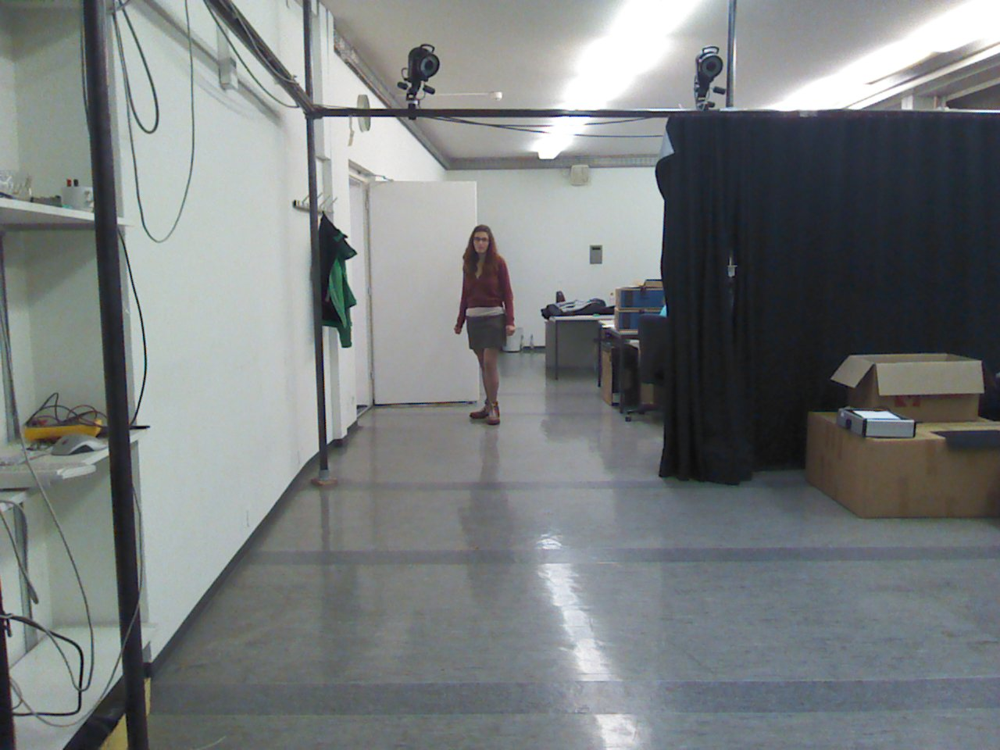

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 606.24909648  297.39251736  623.93218765  320.54781893    0.9998647 ]]


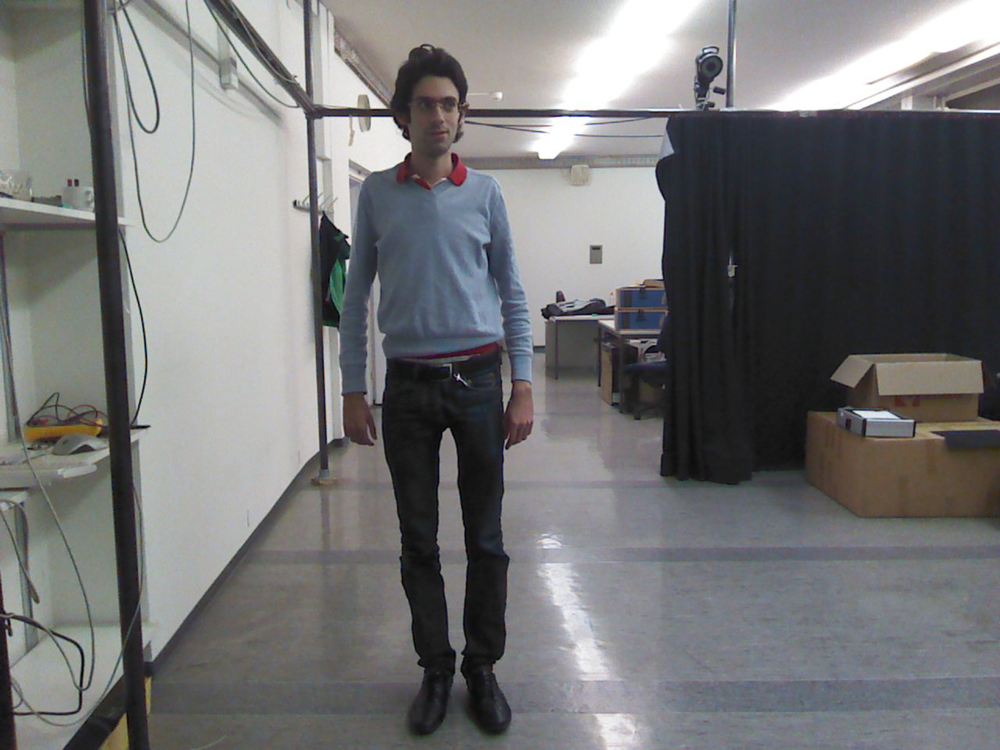

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 520.8271423   102.55152717  587.68859119  189.56509556    0.9999907 ]]


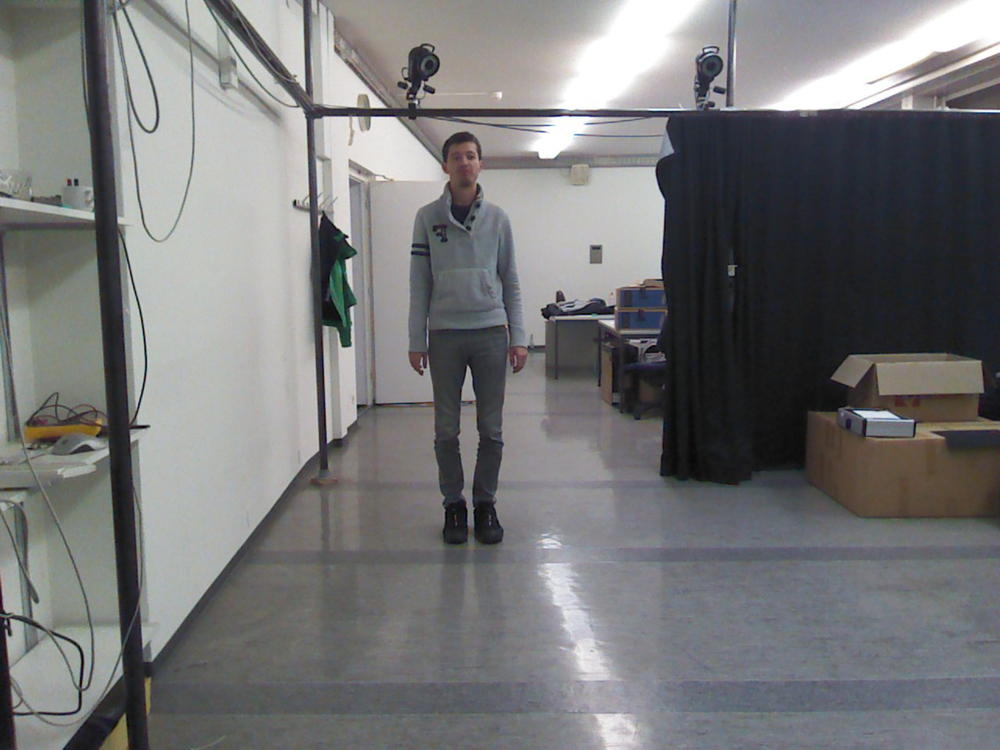

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 571.57345557  183.14607465  610.63924062  231.56004894    0.99998403]]


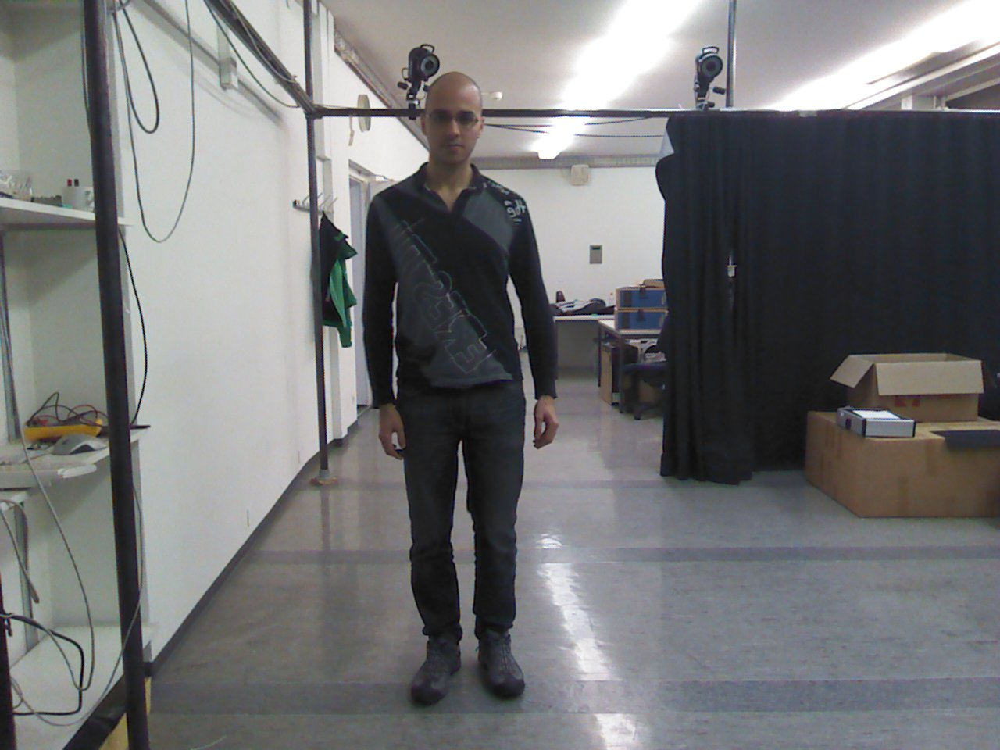

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 544.86780969  119.88914502  612.37882817  205.61483139    0.99999261]]


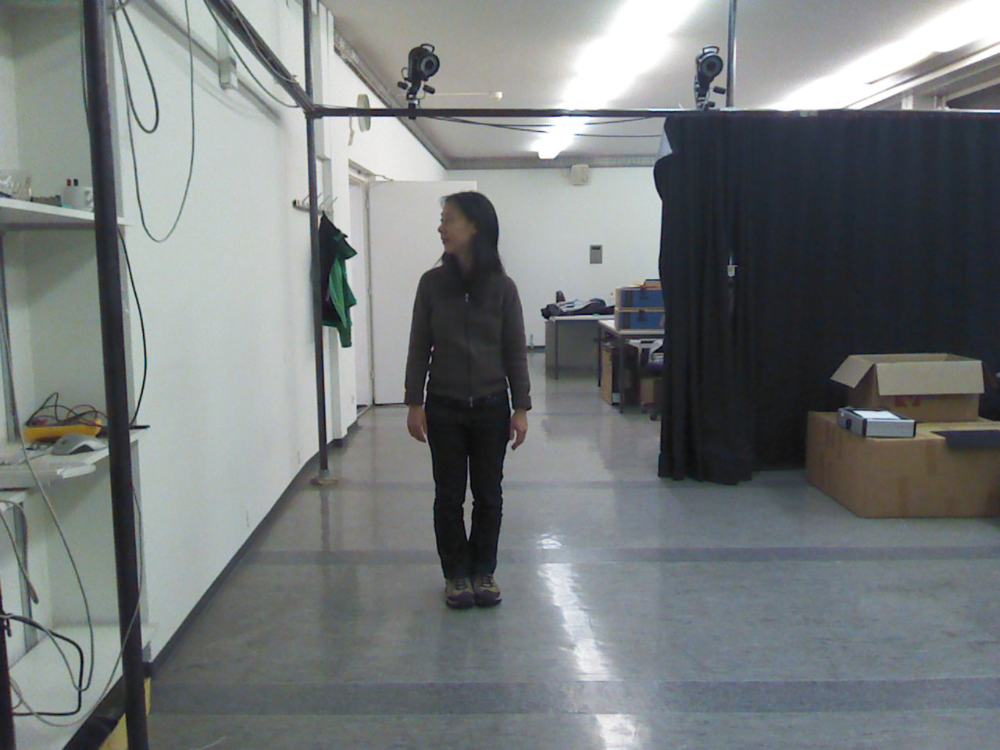

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 558.71191248  258.08192508  599.00607123  319.58271617    0.99816763]]


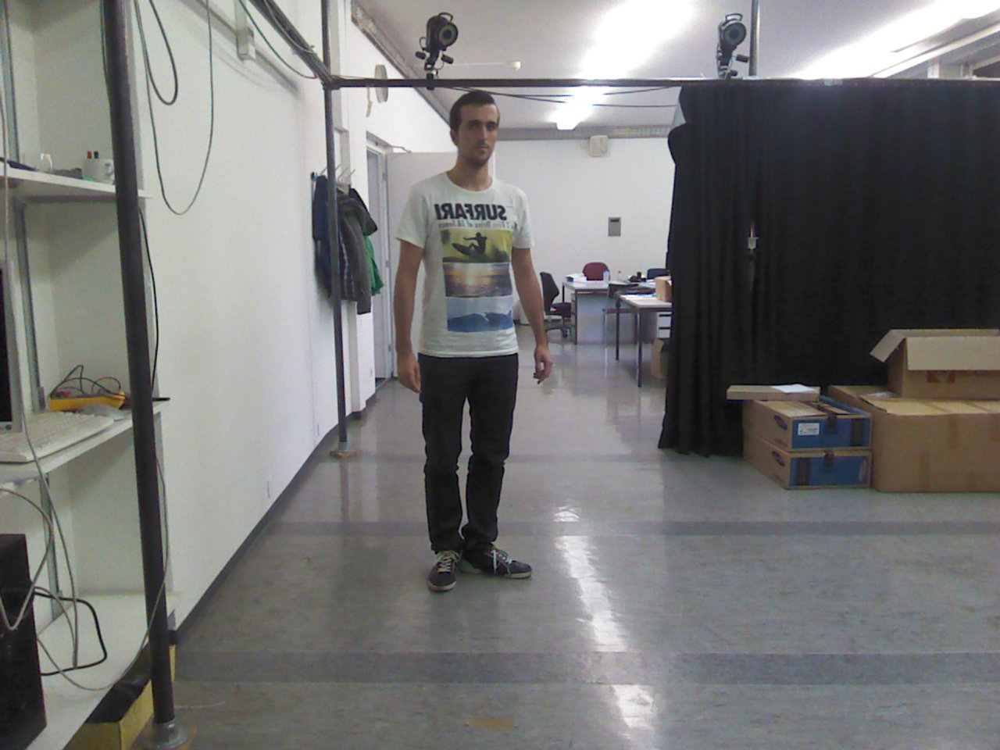

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 587.33983347  135.98433539  638.19575235  204.77472545    0.99987507]]


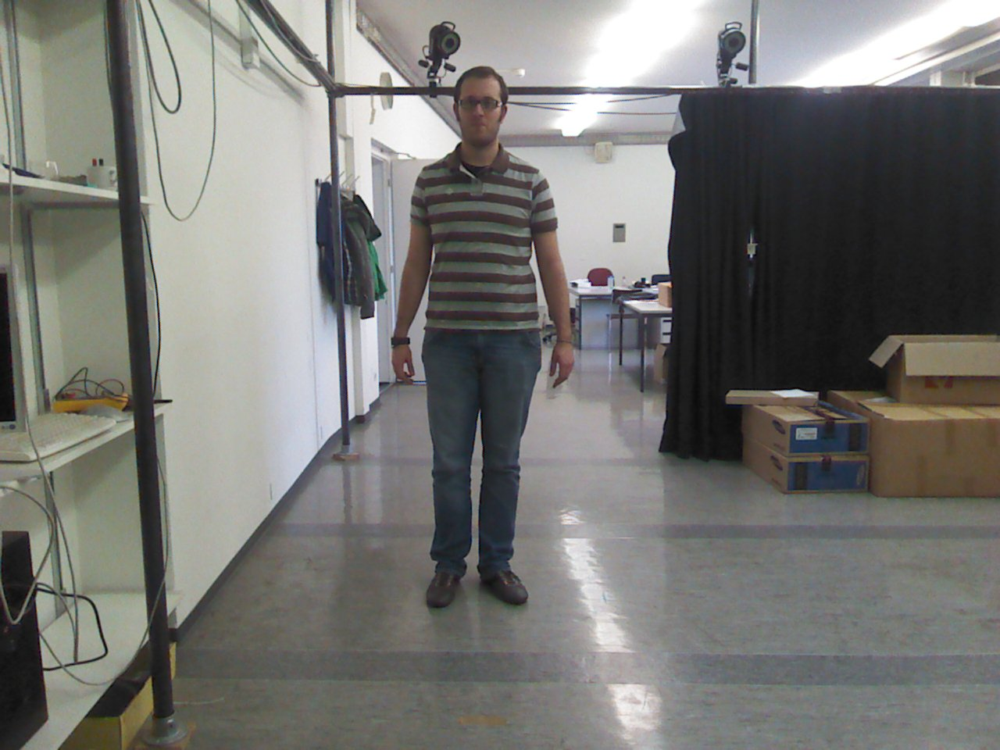

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 584.63345805  104.46651506  638.03582038  175.46961343    0.99998438]]


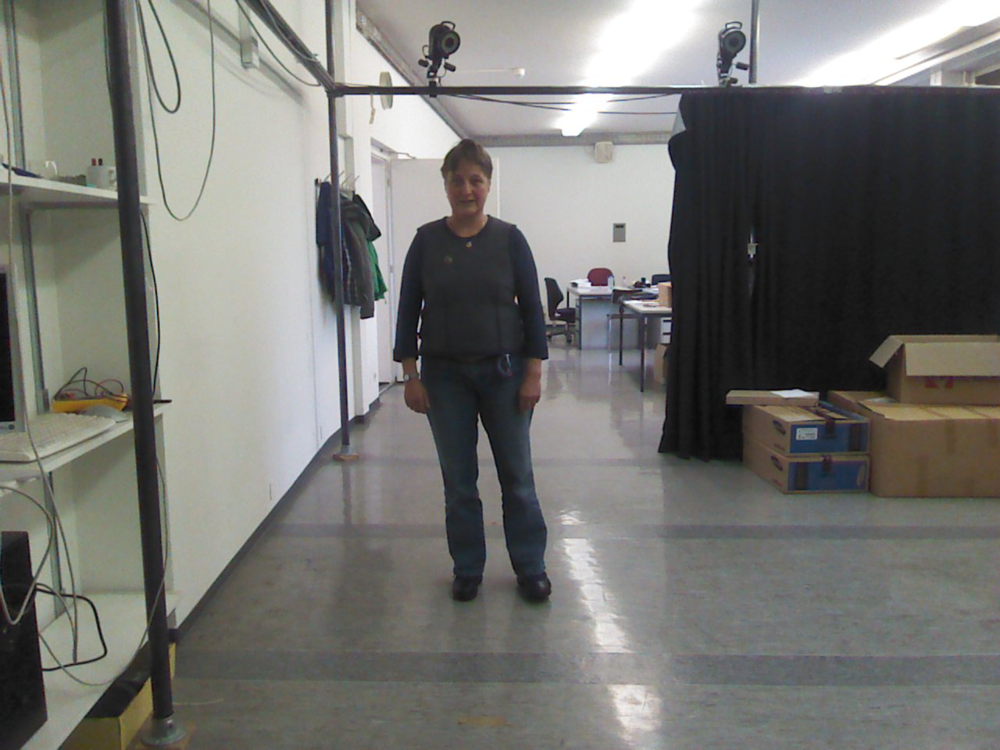

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 568.22613862  207.61561473  623.991433    277.9650833     0.99936241]]


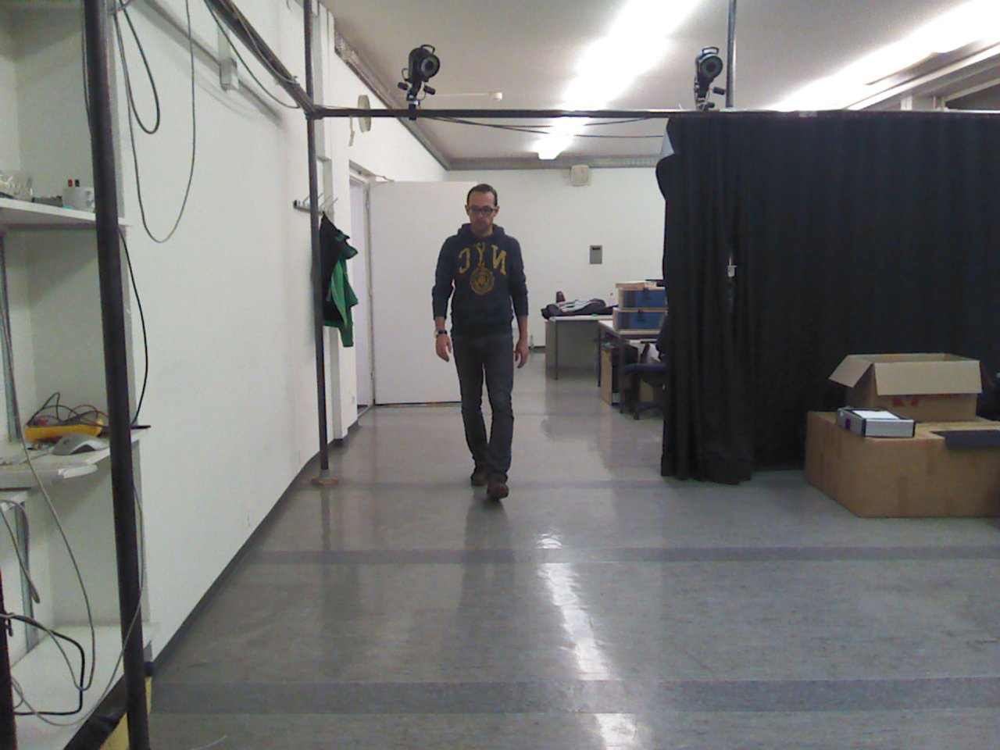

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 599.91729186  252.1980416   631.11299919  295.66273863    0.99880672]]


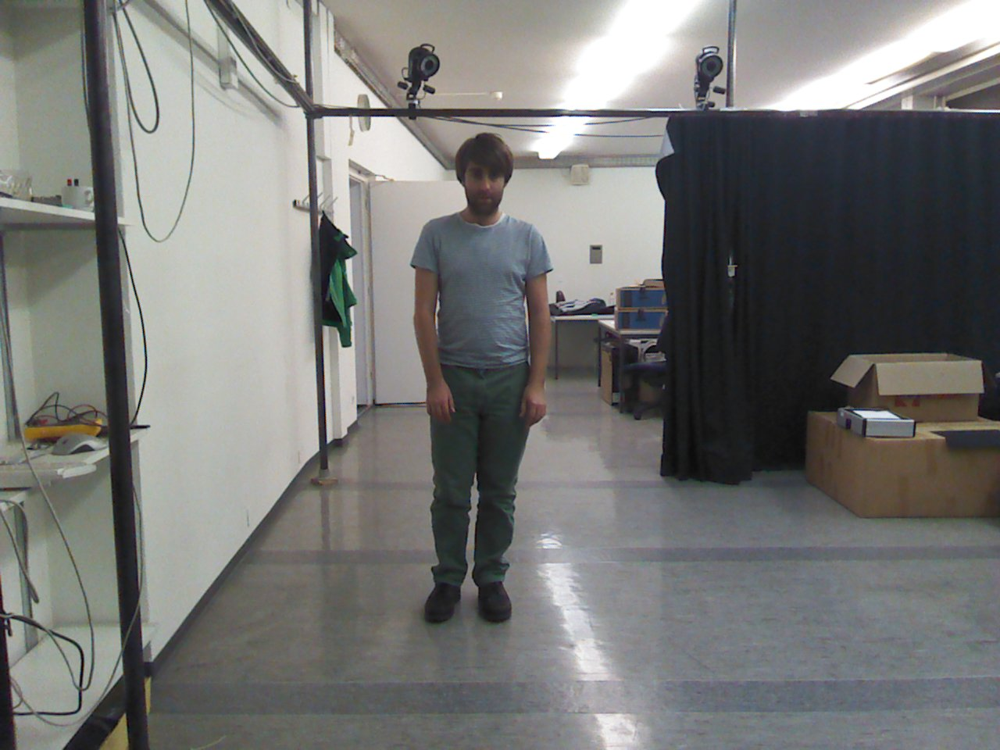

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 590.02118033  196.29721808  648.93020758  272.46630979    0.99957925]]


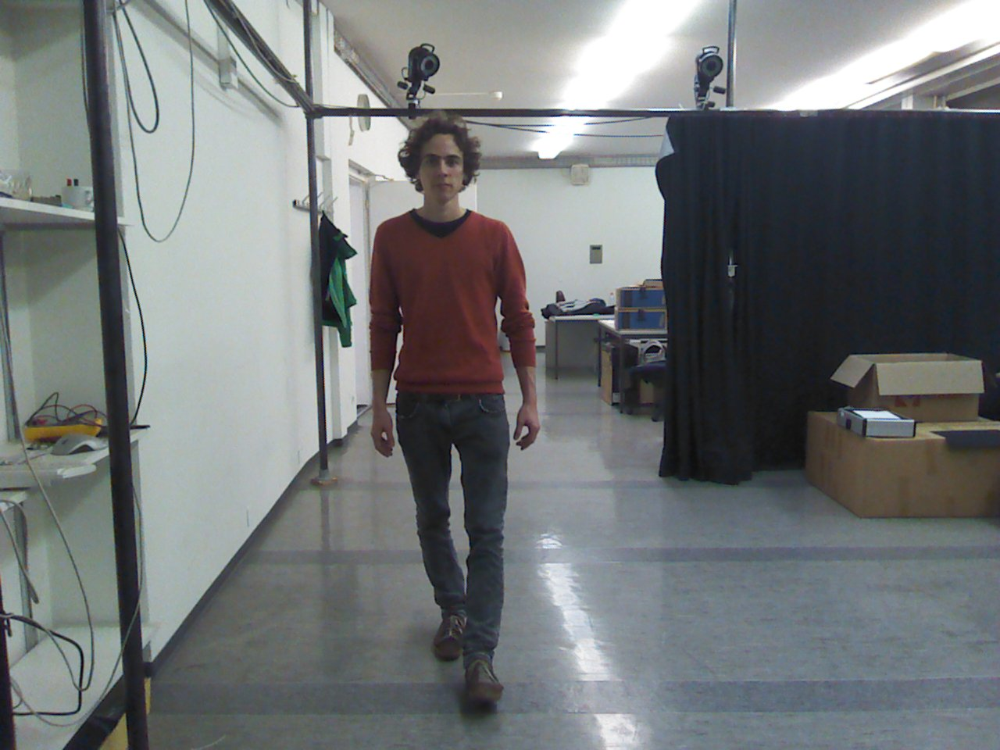

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 535.33211811  178.8667264   591.69723895  252.1600482     0.99997306]]


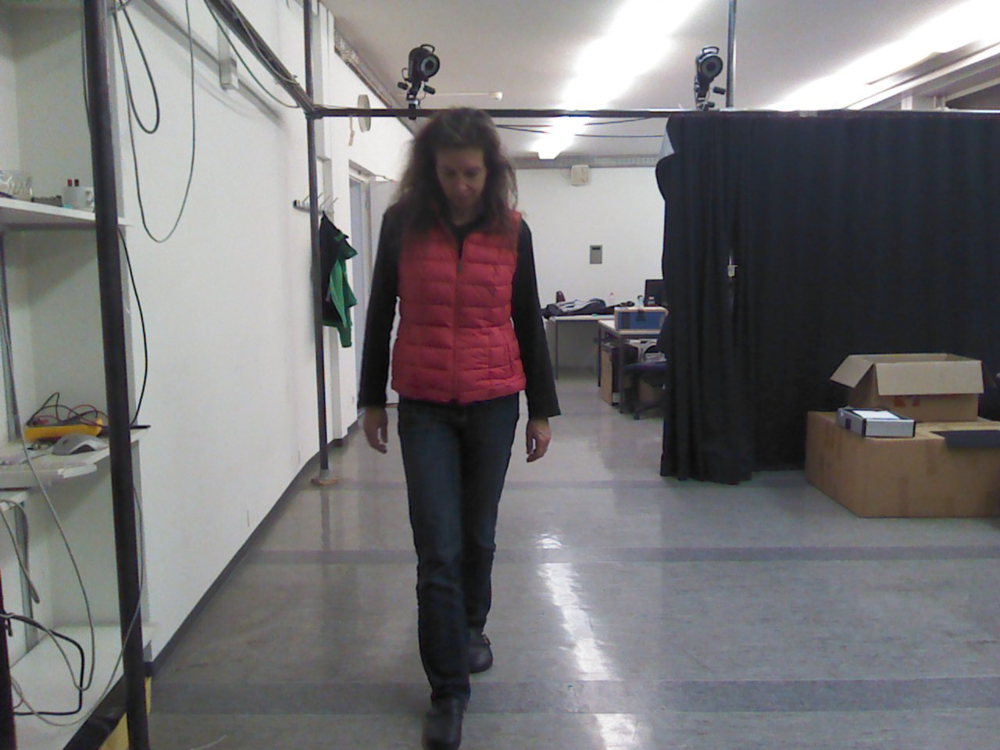

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 559.46764845  191.91373226  617.88024096  265.66156876    0.99954152]]


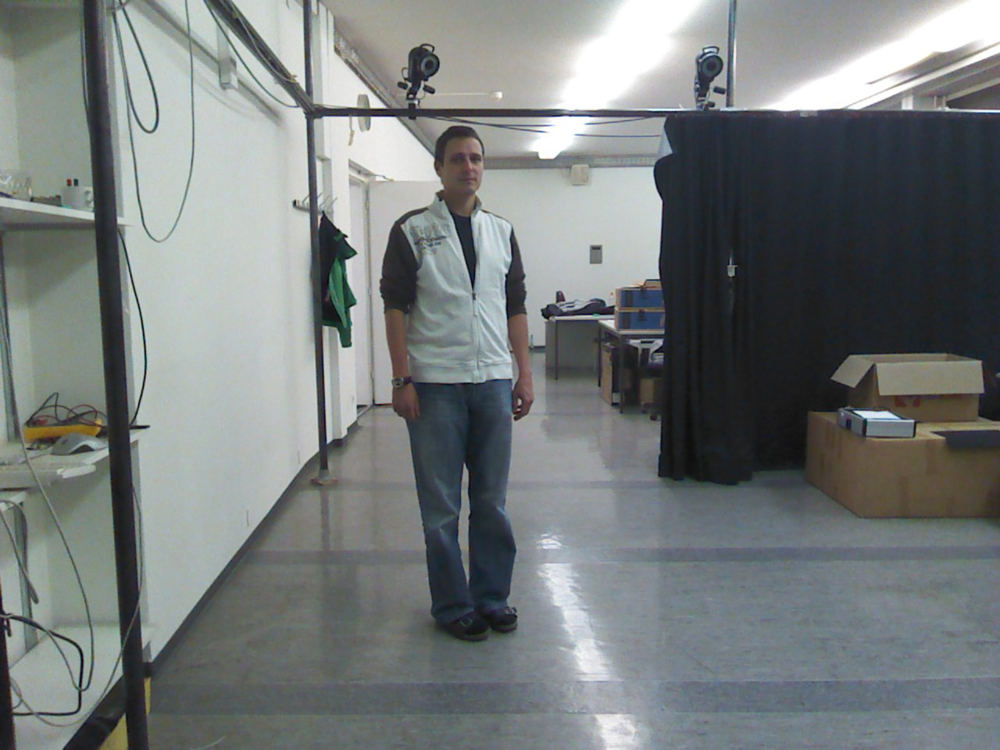

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 567.09528548  178.40170926  619.10861735  246.1818424     0.9999783 ]]


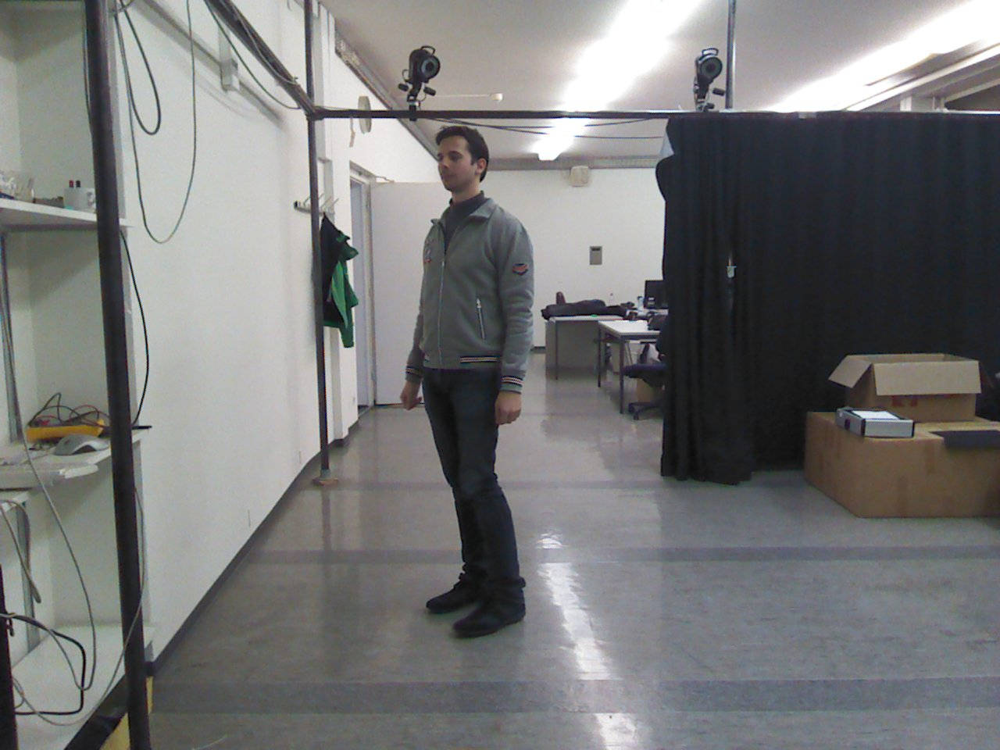

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 556.4473671   177.2774622   604.64613456  239.64093313    0.99999785]]


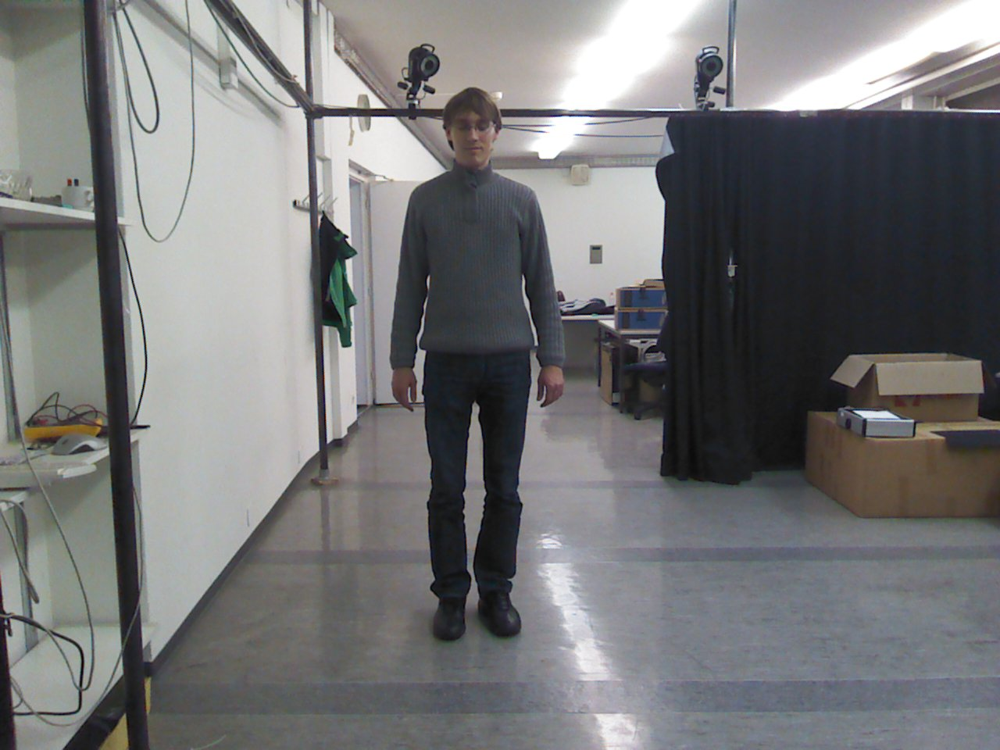

('paaath : ', <type 'numpy.string_'>)
the bbs [[ 573.37439197  135.71563686  632.85925794  207.89110181    0.99998927]]
done!


In [57]:
from IPython.display import Image, display

# detection parameters
minsize = 20 
threshold = [ 0.6, 0.7, 0.7 ]
factor = 0.709
             
boxes = []
keypoints = []
images = []
print('detecting faces...')
for path in np.concatenate((guess, ref), axis=0):
    display(Image(path))
    img = scipy.misc.imread(path)
    bbs, kps = align.detect_face.detect_face(img, minsize, 
                                             pnet, rnet, onet, threshold, factor)
    kps = np.asarray(kps)
    print(kps.shape)
    kps = kps.reshape([2,5,-1]).T

    # Should always happen
    if len(kps) != 0:  
        images.append(img)  
        boxes.append(bbs)
        keypoints.append(kps)
print('done!')  

In [73]:
print('computing embeddings')
size = 160
margin = 32

faces = []
faces_embs = []

for img, bbs in zip(images, boxes):
  img_faces = []
  for x0,y0,x1,y1,_ in bbs.astype(np.int32):
    x0 = np.maximum(x0 - margin//2, 0)
    y0 = np.maximum(y0 - margin//2, 0)
    x1 = np.minimum(x1 + margin//2, img.shape[1])
    y1 = np.minimum(y1 + margin//2, img.shape[0])
    img_faces.append(scipy.misc.imresize(img[y0:y1,x0:x1], (size, size)))
  img_faces = np.stack(img_faces)
  faces.append(img_faces)
  
  feed_dict = {
    images_in : img_faces.astype(np.float32) / 255.0,
      
    phase_train_in : False,
  }
  
  faces_embs.append(sess.run(embeddings, feed_dict))  
print('done!')

computing embeddings
done!


In [78]:
type(faces[1])

numpy.ndarray

In [59]:
len(guess)

28

In [60]:
len(ref)

50

In [61]:
len(faces_embs)

78

In [14]:

hostFaces = np.concatenate((faces[1], faces[2]), axis = 0)

In [16]:
host = np.concatenate((faces_embs[1], faces_embs[2]), axis = 0)

In [160]:
ref_emb = np.concatenate((faces_embs[len(guess) + 1], faces_embs[len(guess) + 2]), axis = 0)
refFaces = np.concatenate((faces[len(guess) + 1], faces[len(guess) + 2]), axis = 0)

for i in range(len(guess) + 3, len(faces_embs)):
    ref_emb = np.concatenate((ref_emb, faces_embs[i]), axis = 0)
    refFaces = np.concatenate((refFaces, faces[i]), axis = 0)

In [161]:
guess_emb = np.concatenate((faces_embs[0], faces_embs[1]), axis = 0)
guessFaces = np.concatenate((faces[0], faces[1]), axis = 0)

for i in range(2, len(guess)):
    guess_emb = np.concatenate((guess_emb, faces_embs[i]), axis = 0)
    guessFaces = np.concatenate((guessFaces, faces[i]), axis = 0)

i 0
0.842021186362
i 1
0.984514959045
i 2
0.929012531446
i 3
0.805495752718
i 4
0.527386441204
i 5
0.951385806825
i 6
0.409430937491
i 7
1.16954781886
i 8
0.78868367351
i 9
0.379357027726
i 10
0.924662392509
i 11
0.69635335568
i 12
0.966562026849
i 13
0.914749570734
i 14
0.7654761314
i 15
1.07006241084
i 16
0.397973748662
i 17
0.780739746391
i 18
1.1243417295
i 19
0.84362908812
i 20
1.05165127039
i 21
0.566439829271
i 22
0.752795100385
i 23
1.02701057858
i 24
0.38089064382
i 25
0.877225801409
i 26
0.833251129877
i 27
0.852610414612
i 28
1.04579235074


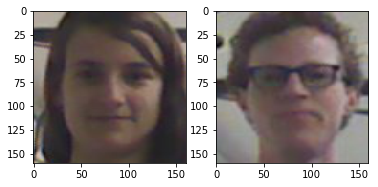

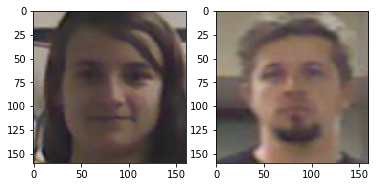

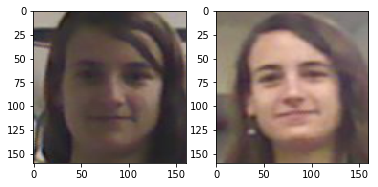

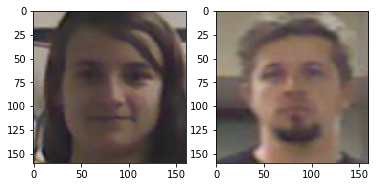

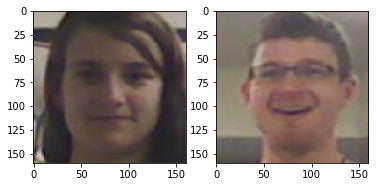

...

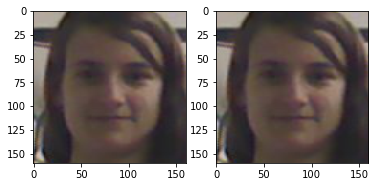

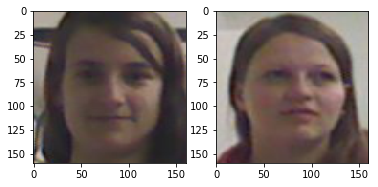

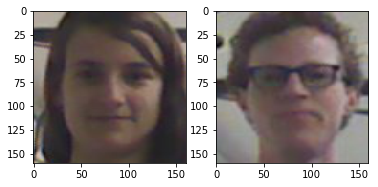

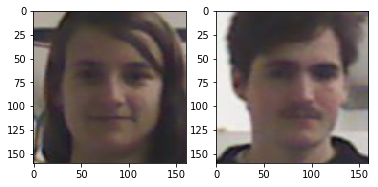

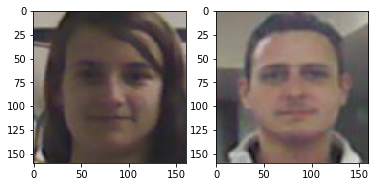

In [163]:
import math
# Euclidian distance of the 2 first picture's faces
# compare each guess ambedding faces to all the ref embedding faces
dist = distance.cdist(guess_emb, ref_emb)

for i in range(len(guess_emb)):
    # idx is the arg i that minimize the euclidian distance between the face of faces_embs[1] and faces_embs[2]
    print("i " + str(i))
    idx = np.argmin(dist[i])
    print(np.min(dist[i]))
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(refFaces[j])
    plt.subplot(1,2,2)
    plt.imshow(faces[idx][0]) #[idx])
    #print(i, idx)

i 0
0.842021186362
(1, 160, 160, 3)
i 0
0.984514959045
(1, 160, 160, 3)
i 0
0.929012531446
(1, 160, 160, 3)
i 0
0.805495752718
(1, 160, 160, 3)
i 0
0.527386441204
(1, 160, 160, 3)
i 0
0.951385806825
(1, 160, 160, 3)
i 0
0.409430937491
(1, 160, 160, 3)
i 0
1.16954781886
(1, 160, 160, 3)
i 0
0.78868367351
(1, 160, 160, 3)
i 0
0.924662392509
(1, 160, 160, 3)
i 0
0.69635335568
(1, 160, 160, 3)
i 0
0.966562026849
(1, 160, 160, 3)
i 0
0.914749570734
(1, 160, 160, 3)
i 0
0.7654761314
(1, 160, 160, 3)
i 0
1.07006241084
(1, 160, 160, 3)
i 0
0.397973748662
(1, 160, 160, 3)
i 0
0.780739746391
(1, 160, 160, 3)
i 0
1.1243417295
(1, 160, 160, 3)
i 0
0.84362908812
(1, 160, 160, 3)
i 0
1.05165127039
(1, 160, 160, 3)
i 0
0.566439829271
(1, 160, 160, 3)
i 0
0.752795100385
(1, 160, 160, 3)
i 0
1.02701057858
(1, 160, 160, 3)
i 0
0.38089064382
(1, 160, 160, 3)
i 0
0.877225801409
(1, 160, 160, 3)
i 0
0.833251129877
(1, 160, 160, 3)
i 0
0.852610414612
(1, 160, 160, 3)
i 0
1.04579235074
(1, 160, 160, 3)


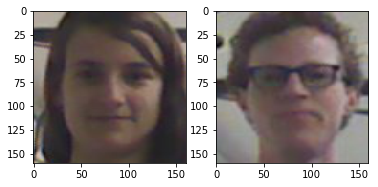

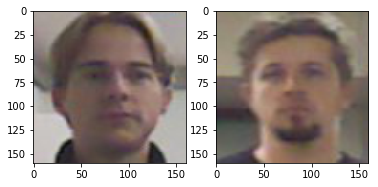

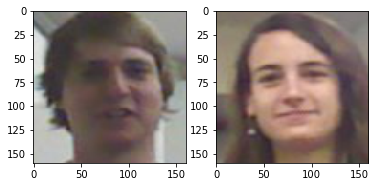

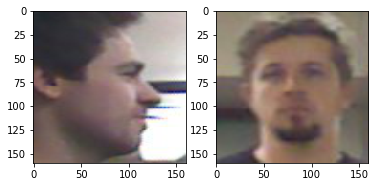

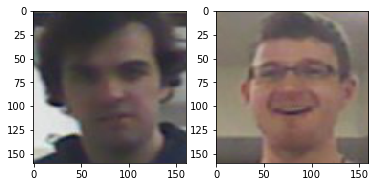

...

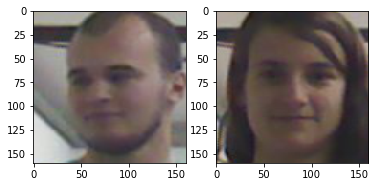

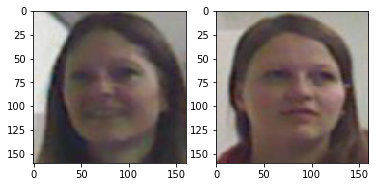

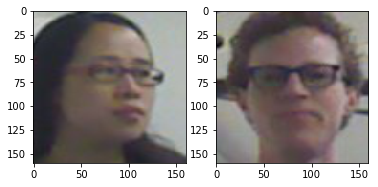

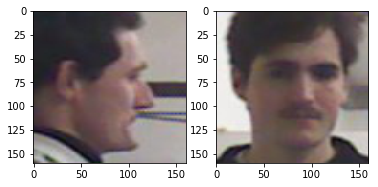

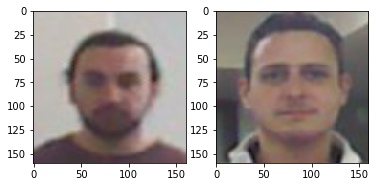

In [119]:
import math
# Euclidian distance of the 2 first picture's faces
# compare each guess ambedding faces to all the ref embedding faces
for j in range(len(guess)):
    dist = distance.cdist(faces_embs[j], ref_emb)

    for i in range(1):
        # idx is the arg i that minimize the euclidian distance between the face of faces_embs[1] and faces_embs[2]
        print("i " + str(i))
        idx = np.argmin(dist[i])
        print(np.min(dist[i]))
        plt.figure()
        plt.subplot(1,2,1)
        plt.imshow(refFaces[j])
        plt.subplot(1,2,2)
        plt.imshow(faces[idx][0]) #[idx])
        #print(i, idx)

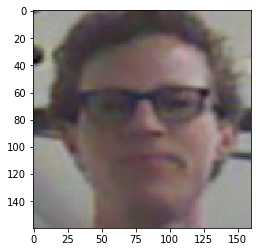

In [124]:
plt.imshow(faces[37][0])

0.842021186362
(0, 37)
0.984514959045
(0, 0)
0.929012531446
(0, 1)
0.805495752718
(0, 0)
0.527386441204
(0, 9)
0.951385806825
(0, 18)
0.409430937491
(0, 10)
1.16954781886
(0, 14)
0.78868367351
(0, 15)
0.924662392509
(0, 16)
0.69635335568
(0, 16)
0.966562026849
(0, 21)
0.914749570734
(0, 20)
0.7654761314
(0, 22)
1.07006241084
(0, 13)
0.397973748662
(0, 10)
0.780739746391
(0, 2)
1.1243417295
(0, 28)
0.84362908812
(0, 17)
1.05165127039
(0, 4)
0.566439829271
(0, 42)
0.752795100385
(0, 38)
1.02701057858
(0, 40)
0.38089064382
(0, 29)
0.877225801409
(0, 42)
0.833251129877
(0, 37)
0.852610414612
(0, 47)
1.04579235074
(0, 26)


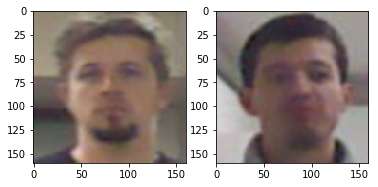

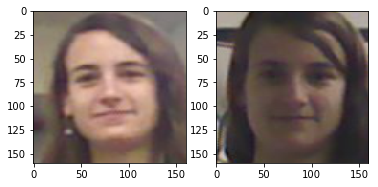

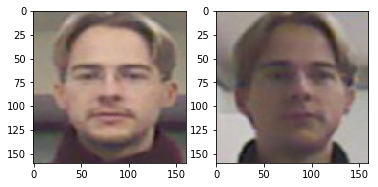

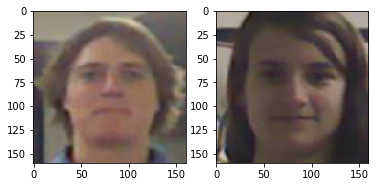

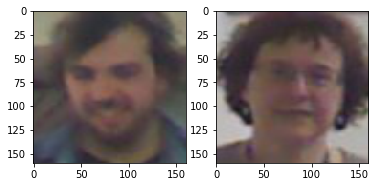

...

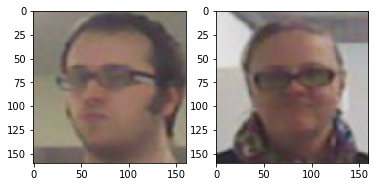

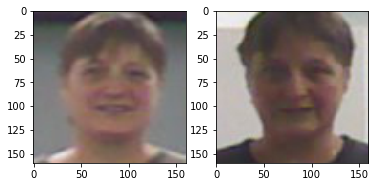

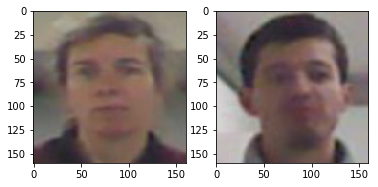

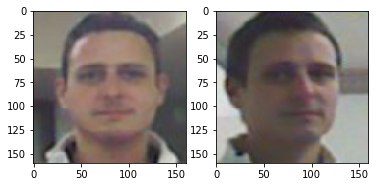

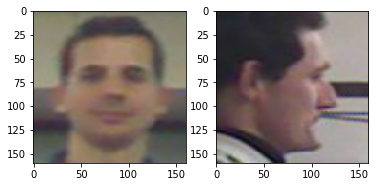

In [158]:
for index in range(len(guess)):
    dist = distance.cdist(faces_embs[index], ref_emb)

    for i in range(faces_embs[0].shape[0]):
        idx = np.argmin(dist[i])
        print(np.min(dist[i]))
        plt.figure(index)
        plt.subplot(1,2,1)
        plt.imshow(faces[index][0]) #[idx])
        plt.subplot(1,2,2)
        plt.imshow(refFaces[idx])
        print(i, idx)

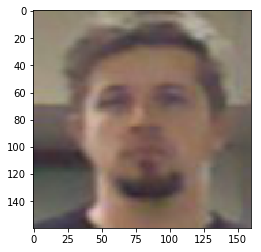

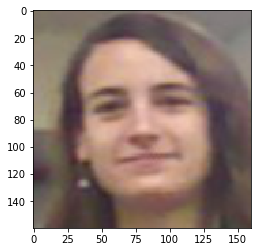

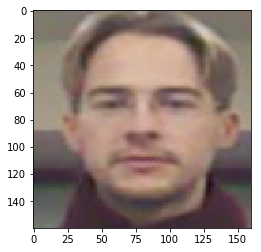

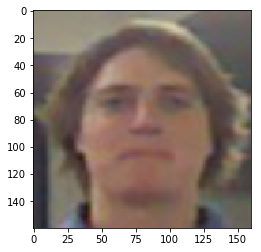

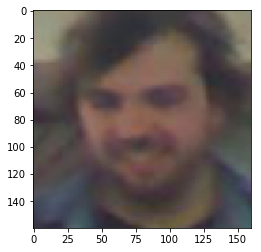

...

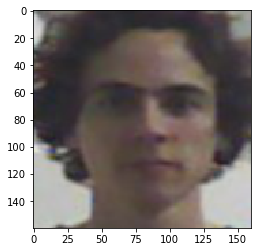

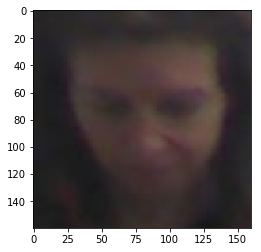

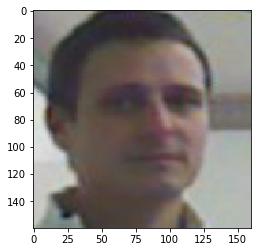

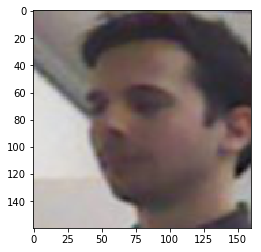

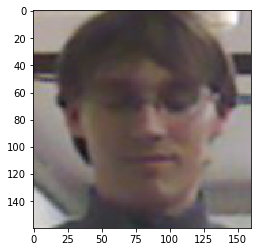

In [139]:
for i in range(len(faces_embs)):
    plt.figure(i)
    plt.imshow(faces[i][0])


In [138]:
faces[0][0].shape

(1, 160, 160, 3)